<a href="https://colab.research.google.com/github/spdsp04/Finance_and_Risk_Analytics/blob/main/Finance_and_Risk_Analytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Finance and Risk Analytics Project

### Problem Statment:
Consider yourself working for an associate at an investment firm that manages accounts for private clients. Your role requires you to analyze a portfolio of stocks to provide consultation on investment management based on client requirements. 

Your task is to provide consultation to two different investors, Mr. Patrick Jyenger and Mr. Peter Jyenger based on their requirements and financial objectives. You can refer to the elements mentioned in the video to develop the investor persona.

### Investor Profile:

1. MR. PATRIC JYENGER:
    - Age 55 years

    - Successful first generation entrepreneur

    - Owner of Jyenger Water wWorks (JWW)

    - Considering business succession plan and retirement

    - Conservative investor

    - Wants to maintain descent style of living

    - Wants to invest 500k USD in equities

    - Wants to make it 1 mn in five years duration




2. MR. PETER JYENGER: 
    - Age 32 years 
    
    - Son of Mr. Petric Jyenger
    
    - Risk taker
    
    - Feels financial secured
    
    - Aggressive investor
    
    - Preferes high return investment
    
    - Wants to invest 1 million USD 
    
    - Wants to invest in most high margin stocks for inorganic expansion of JWW in future
    
    - Duration of investment: less than 5 years






### Codes used for representing S&P500 index and 24 given stocks of different sectors

    1. SP500: S&P500 index

    2. AAL_Avi:American Airlines Group Inc, Travel/Aviation/Hospitality Sector
    3. ALGT_Avi:Allegiant Travel Company, TTravel/Aviation/Hospitality Sector
    4. ALK_Avi:Alaska Air Group Inc, Travel/Aviation/Hospitality Sector
    5. DAL_Avi: Delta Air Lines Inc, Travel/Aviation/Hospitality Sector
    6. HA_Avi: Hawaiian Holdings Inc, Travel/Aviation/Hospitality Sector
    7. LUV_Avi: Southwest Airlines Co, Travel/Aviation/Hospitality Sector

    8. BCS_Fin: Barclays, Banking/Financial Services and Insurance Sector
    9. CS_Fin:  Credit Suisse, Banking/Financial Services and Insurance Sector
    10.DB_Fin:  Deutsche Bank, Banking/Financial Services and Insurance Sector
    11.GS_Fin:  Goldman Sachs, Banking/Financial Services and Insurance Sector
    12.MS_Fin:  Morgan Stanley, Banking/Financial Services and Insurance Sector
    13.WFC_Fin: Wells Fargo, Banking/Financial Services and Insurance Sector

    14.JNJ_Ph: Johnson & Johnson, Pharmaceuticals/Healthcare/Life Sciences Sector
    15.MRK_Ph: Merck and Co inc., Pharmaceuticals/Healthcare/Life Sciences Sector
    16.PFE_Ph: Pfizer inc, Pharmaceuticals/Healthcare/Life Sciences Sector
    17.UNH_Ph: United Health Group Inc, Pharmaceuticals/Healthcare/Life Sciences Sector
    18.BHC_Ph: Bausch Health Companies inc,Pharmaceuticals/Healthcare/Life Sciences Sector
    19.RHHBY_Ph: Roche Holding AG, Pharmaceuticals/Healthcare/Life Sciences Sector

    20.AAPL_Tech: Apple Inc, Technology/IT Sector
    21.AMZN_Tech: Amazon, Technology/IT Sector
    22.FB_Tech:   Facebook, Technology/IT Sector
    23.GOOG_Tech: Alphabet (Google), Technology/IT Sector
    24.IBM_Tech: IBM, Technology/IT Sector
    25.MSFT_Tech: Microsoft, Technology/IT Sector

In [ ]:
# Importing required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns





from copy import copy
from scipy import stats
import plotly.figure_factory as ff
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
import math

#ignoring the warnings
import warnings
warnings.filterwarnings("ignore")

## Data Reading

In [ ]:
# Loading the S&P500 csv file into dataframe
sp500_df = pd.read_csv('S&P500.csv')

#### Reading Aviation Sector Stocks data

In [ ]:
# Loading the csv files of aviaiton sector into dataframes
AAL_Avi_df = pd.read_csv('AAL.csv') # reading data of American Airlines stock
ALGT_Avi_df = pd.read_csv('ALGT.csv') # reading data of Allegiant Travel Company stock
ALK_Avi_df= pd.read_csv('ALK.csv') # reading data of Alaska Air Group stock
DAL_Avi_df = pd.read_csv('DAL.csv') # reading data of Delta Airlines stock
HA_Avi_df = pd.read_csv('HA.csv') # reading data of Hawaiian Holdings  stock
LUV_Avi_df = pd.read_csv('LUV.csv') # reading data of Southwest Airlines stock

#### Reading Stocks of Finance Sector

In [ ]:
# Loading the csv files of finance sector into dataframes
BCS_Fin_df = pd.read_csv('BCS.csv') # reading data of Baclays PLC stock
CS_Fin_df = pd.read_csv('CS.csv') # reading data of Credit Suisee Group stock
DB_Fin_df= pd.read_csv('DB.csv') # reading data of Deutsche Bank stock
GS_Fin_df = pd.read_csv('GS.csv') # reading data of Goldman Sachs stock
MS_Fin_df = pd.read_csv('MS.csv') # reading data of Morgan Stanley  stock
WFC_Fin_df = pd.read_csv('WFC.csv') # reading data of Wells Fargo & stock

#### Reading stocks of Healthcare and Pharma Sector

In [ ]:
# Loading the csv files of healthcare and pharmaceuticals sector into dataframes
BHC_Pharma_df = pd.read_csv('BHC.csv') # reading data of Bausch Health Companies inc
JNJ_Pharma_df = pd.read_csv('JNJ.csv') # reading data of  Johnson & Johnson
MRK_Pharma_df = pd.read_csv('MRK.csv') # reading data of Merck and CO inc
PFE_Pharma_df = pd.read_csv('PFE.csv') # reading data of Pfizer inc
RHHBY_Pharma_df = pd.read_csv('RHHBY.csv') # reading data of Roche Holding AG
UNH_Pharma_df = pd.read_csv('UNH.csv') # reading data of United Health Group Inc

#### Reading stocks of Technology Sector

In [ ]:
# Loading the csv files of technology sector into dataframes
AAPL_Tech = pd.read_csv('AAPL.csv') # Reading Apple stock data
AMZN_Tech = pd.read_csv('AMZN.csv') # Reading Amazon stock data
FB_Tech = pd.read_csv('FB.csv') #  Reading Meta (Facebook) stock data
GOOG_Tech = pd.read_csv('GOOG.csv') # Reading Alphabet (Google) stock data
IBM_Tech = pd.read_csv('IBM.csv') # Reading IBM stock data
MSFT_Tech = pd.read_csv('MSFT.csv') # Reading Microsoft stock data

#### NOTE:  For this assignment, I have  used 'Adj Close' price  as the "daily close price" of the above 25 entities as per the suggestions given by various financial experts.

### Data Cleaning and Manipulation

#### 1. S&P500 Index 

In [ ]:
# Ensuring display of all columns
pd.set_option('display.max_columns', None)

In [ ]:
# Checking shape of the dataframe
sp500_df.shape

(2517, 7)

In [ ]:
# Checking column names
sp500_df.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')

In [ ]:
# Checking data types of columns of sp500_df
sp500_df.dtypes

Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume         int64
dtype: object

In [ ]:
# Inspecting statistical properties
sp500_df.describe()

,Open,High,Low,Close,Adj Close,Volume
count,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2.517000e+03
mean,2110.972959,2121.516622,2099.447811,2111.392732,2111.392732,3.739228e+09
std,612.451995,614.993509,609.248031,612.227235,612.227235,8.805742e+08
min,1097.420044,1125.119995,1074.770020,1099.229980,1099.229980,1.025000e+09
25%,1560.699951,1564.910034,1551.900024,1562.170044,1562.170044,3.241030e+09
50%,2070.750000,2079.620117,2058.840088,2071.219971,2071.219971,3.591270e+09
75%,2657.360107,2674.719971,2638.169922,2656.300049,2656.300049,4.060610e+09
max,3564.739990,3588.110107,3535.229980,3580.840088,3580.840088,9.044690e+09


In [ ]:
# Inspecting sp500_df
sp500_df.info

<bound method DataFrame.info of             Date         Open         High          Low        Close  \
0     01-10-2010  1143.489990  1150.300049  1139.420044  1146.239990   
1     04-10-2010  1144.959961  1148.160034  1131.869995  1137.030029   
2     05-10-2010  1140.680054  1162.760010  1140.680054  1160.750000   
3     06-10-2010  1159.810059  1162.329956  1154.849976  1159.969971   
4     07-10-2010  1161.569946  1163.869995  1151.410034  1158.060059   
...          ...          ...          ...          ...          ...   
2512  24-09-2020  3226.139893  3278.699951  3209.449951  3246.590088   
2513  25-09-2020  3236.659912  3306.879883  3228.439941  3298.459961   
2514  28-09-2020  3333.899902  3360.739990  3332.909912  3351.600098   
2515  29-09-2020  3350.919922  3357.919922  3327.540039  3335.469971   
2516  30-09-2020  3341.210000  3393.560000  3340.470000  3363.000000   

        Adj Close      Volume  
0     1146.239990  4298910000  
1     1137.030029  3604110000  
2     1

In [ ]:
# Changing datetype of Date column from object to datetime type
sp500_df['Date'] =  pd.to_datetime(sp500_df['Date'], format='%d-%m-%Y')

In [ ]:
# Confirming change of datatype
sp500_df.dtypes

Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume                int64
dtype: object

In [ ]:
# Sort the sp500 data by date
sp500_df= sp500_df.sort_values(by = ['Date'])
sp500_df.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,2010-10-01,1143.489990,1150.300049,1139.420044,1146.239990,1146.239990,4298910000
1,2010-10-04,1144.959961,1148.160034,1131.869995,1137.030029,1137.030029,3604110000
2,2010-10-05,1140.680054,1162.760010,1140.680054,1160.750000,1160.750000,4068840000
3,2010-10-06,1159.810059,1162.329956,1154.849976,1159.969971,1159.969971,4073160000
4,2010-10-07,1161.569946,1163.869995,1151.410034,1158.060059,1158.060059,3910550000


In [ ]:
# Removing addtional data, if any,  based on the dates given
sp500_df = sp500_df.loc[(sp500_df['Date'] >= '2010-10-01')
                     & (sp500_df['Date'] <= '2020-09-30')]
sp500_df

,Date,Open,High,Low,Close,Adj Close,Volume
0,2010-10-01,1143.489990,1150.300049,1139.420044,1146.239990,1146.239990,4298910000
1,2010-10-04,1144.959961,1148.160034,1131.869995,1137.030029,1137.030029,3604110000
2,2010-10-05,1140.680054,1162.760010,1140.680054,1160.750000,1160.750000,4068840000
3,2010-10-06,1159.810059,1162.329956,1154.849976,1159.969971,1159.969971,4073160000
4,2010-10-07,1161.569946,1163.869995,1151.410034,1158.060059,1158.060059,3910550000
...,...,...,...,...,...,...,...
2512,2020-09-24,3226.139893,3278.699951,3209.449951,3246.590088,3246.590088,4599470000
2513,2020-09-25,3236.659912,3306.879883,3228.439941,3298.459961,3298.459961,3792220000
2514,2020-09-28,3333.899902,3360.739990,3332.909912,3351.600098,3351.600098,3946060000
2515,2020-09-29,3350.919922,3357.919922,3327.540039,3335.469971,3335.469971,3651880000


In [ ]:
# Checking for missing  values
sp500_df.isnull().sum()

Date         0
Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [ ]:
# Dropping all columns except Date and Adj Close to creat sp500_price dataframe
sp500_price_df= sp500_df.drop(['Open', 'High', 'Low', 'Close', 'Volume'], axis=1)
sp500_price_df

,Date,Adj Close
0,2010-10-01,1146.239990
1,2010-10-04,1137.030029
2,2010-10-05,1160.750000
3,2010-10-06,1159.969971
4,2010-10-07,1158.060059
...,...,...
2512,2020-09-24,3246.590088
2513,2020-09-25,3298.459961
2514,2020-09-28,3351.600098
2515,2020-09-29,3335.469971


In [ ]:
# Dropping all columns except Date and Adj Close to creat sp500_volume dataframe
sp500_volume_df= sp500_df.drop(['Open', 'High', 'Low', 'Close', 'Adj Close'], axis=1)
sp500_volume_df

,Date,Volume
0,2010-10-01,4298910000
1,2010-10-04,3604110000
2,2010-10-05,4068840000
3,2010-10-06,4073160000
4,2010-10-07,3910550000
...,...,...
2512,2020-09-24,4599470000
2513,2020-09-25,3792220000
2514,2020-09-28,3946060000
2515,2020-09-29,3651880000


#### 2. Aviation Sector Stocks


In [ ]:
# Inspcting American Airlines stock data
AAL_Avi_df.info

<bound method DataFrame.info of             Date   Open   High    Low  Close  Adj Close    Volume
0     01-10-2010   9.29   9.39   9.21   9.29   8.758067   3603800
1     04-10-2010   9.24   9.48   9.05   9.12   8.597802   3856800
2     05-10-2010   9.27   9.35   9.15   9.23   8.701504   3896600
3     06-10-2010   9.27   9.40   9.15   9.23   8.701504   3230200
4     07-10-2010   9.30   9.31   9.07   9.24   8.710930   3877700
...          ...    ...    ...    ...    ...        ...       ...
2512  24-09-2020  11.74  12.00  11.22  11.77  11.770000  49163200
2513  25-09-2020  11.76  12.31  11.71  12.29  12.290000  43764000
2514  28-09-2020  12.74  13.15  12.49  12.76  12.760000  63558200
2515  29-09-2020  12.59  12.66  12.11  12.25  12.250000  46994300
2516  30-09-2020  12.32  12.92  12.22  12.29  12.290000  65055100

[2517 rows x 7 columns]>

In [ ]:
# Inspcting ALGT stock data
ALGT_Avi_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     01-10-2010  42.779999  43.259998  41.869999  43.230000  36.766212   
1     04-10-2010  43.250000  43.330002  41.310001  41.590000  35.371429   
2     05-10-2010  41.779999  42.130001  41.299999  42.099998  35.805168   
3     06-10-2010  42.080002  42.349998  41.349998  41.950001  35.677608   
4     07-10-2010  42.259998  42.270000  41.500000  41.700001  35.464993   
...          ...        ...        ...        ...        ...        ...   
2519         NaN        NaN        NaN        NaN        NaN        NaN   
2520         NaN        NaN        NaN        NaN        NaN        NaN   
2521         NaN        NaN        NaN        NaN        NaN        NaN   
2522         NaN        NaN        NaN        NaN        NaN        NaN   
2523         NaN        NaN        NaN        NaN        NaN        NaN   

        Volume  
0     159100.0  
1     189700.0  
2     175000.0  

In [ ]:
# Inspcting ALL stock data
ALK_Avi_df.info

<bound method DataFrame.info of             Date     Open     High      Low    Close  Adj Close     Volume
0     01-10-2010  12.9325  12.9625  12.3675  12.4475  10.972344  1663600.0
1     04-10-2010  12.4300  12.5900  11.9975  12.1425  10.703489  1512400.0
2     05-10-2010  12.2600  12.2850  11.9450  12.2150  10.767396  2567200.0
3     06-10-2010  12.2200  12.3950  12.0875  12.1875  10.743157  1043600.0
4     07-10-2010  12.2775  12.3450  11.2150  11.6250  10.247319  7682400.0
...          ...      ...      ...      ...      ...        ...        ...
2519         NaN      NaN      NaN      NaN      NaN        NaN        NaN
2520         NaN      NaN      NaN      NaN      NaN        NaN        NaN
2521         NaN      NaN      NaN      NaN      NaN        NaN        NaN
2522         NaN      NaN      NaN      NaN      NaN        NaN        NaN
2523         NaN      NaN      NaN      NaN      NaN        NaN        NaN

[2524 rows x 7 columns]>

In [ ]:
# Inspcting DAL stock data
DAL_Avi_df.info

<bound method DataFrame.info of             Date   Open   High    Low  Close  Adj Close      Volume
0     01-10-2010  11.75  12.01  11.71  12.01  10.668407   9094900.0
1     04-10-2010  11.70  12.01  11.45  11.51  10.224259   7916400.0
2     05-10-2010  11.57  11.87  11.45  11.83  10.508514  12624100.0
3     06-10-2010  11.87  12.05  11.56  11.78  10.464101  10124100.0
4     07-10-2010  11.80  11.82  11.61  11.77  10.455217   7162500.0
...          ...    ...    ...    ...    ...        ...         ...
2519         NaN    NaN    NaN    NaN    NaN        NaN         NaN
2520         NaN    NaN    NaN    NaN    NaN        NaN         NaN
2521         NaN    NaN    NaN    NaN    NaN        NaN         NaN
2522         NaN    NaN    NaN    NaN    NaN        NaN         NaN
2523         NaN    NaN    NaN    NaN    NaN        NaN         NaN

[2524 rows x 7 columns]>

In [ ]:
# Inspcting HA stock data
HA_Avi_df.info

<bound method DataFrame.info of             Date  Open  High   Low  Close  Adj Close     Volume
0     01-10-2010  6.02  6.05  5.88   5.96   5.742526   645400.0
1     04-10-2010  5.96  6.00  5.73   5.75   5.540189   618900.0
2     05-10-2010  5.82  5.93  5.77   5.85   5.636539   534800.0
3     06-10-2010  5.85  6.05  5.85   5.97   5.752162  2563900.0
4     07-10-2010  6.04  6.32  5.98   6.15   5.925593  1115200.0
...          ...   ...   ...   ...    ...        ...        ...
2519         NaN   NaN   NaN   NaN    NaN        NaN        NaN
2520         NaN   NaN   NaN   NaN    NaN        NaN        NaN
2521         NaN   NaN   NaN   NaN    NaN        NaN        NaN
2522         NaN   NaN   NaN   NaN    NaN        NaN        NaN
2523         NaN   NaN   NaN   NaN    NaN        NaN        NaN

[2524 rows x 7 columns]>

In [ ]:
# Inspcting LUV stock data
LUV_Avi_df.info

<bound method DataFrame.info of             Date   Open   High    Low  Close  Adj Close     Volume
0     01-10-2010  13.23  13.24  12.92  12.94  12.018754  5722500.0
1     04-10-2010  12.92  13.09  12.62  12.82  11.907295  6537700.0
2     05-10-2010  12.97  13.16  12.94  13.02  12.093060  8060000.0
3     06-10-2010  12.96  13.10  12.72  12.94  12.018754  7457000.0
4     07-10-2010  12.98  13.03  12.85  12.88  11.963027  3413900.0
...          ...    ...    ...    ...    ...        ...        ...
2519         NaN    NaN    NaN    NaN    NaN        NaN        NaN
2520         NaN    NaN    NaN    NaN    NaN        NaN        NaN
2521         NaN    NaN    NaN    NaN    NaN        NaN        NaN
2522         NaN    NaN    NaN    NaN    NaN        NaN        NaN
2523         NaN    NaN    NaN    NaN    NaN        NaN        NaN

[2524 rows x 7 columns]>

In [ ]:
# Creating a list of aviation sector dataframes
avi_frames = [AAL_Avi_df,ALGT_Avi_df,ALK_Avi_df,DAL_Avi_df,HA_Avi_df,LUV_Avi_df]

In [ ]:
# Creating a function to check shape, name of columns and datatypes of columns of dataframes

def check_dtypes (frame_list):
    for i in frame_list:
        print(i.shape)
        print(i.columns)
        print (i.dtypes)


In [ ]:
# Checking data types of columns of all aviation sector stocks
check_dtypes(avi_frames)

(2517, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume         int64
dtype: object
(2524, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2524, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2524, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Vol

So all the aviation sector stock dataframes are having date column as object. So we need to convert this column to datetime type.

In [ ]:
# Defining a function to change date to datetime type

def change_date_type (frames_list):
    for i in frames_list:
        i['Date'] =  pd.to_datetime(i['Date'], format='%d-%m-%Y')
        print(i.dtypes)

In [ ]:
# Converting date column of all aviation sector stock dataframes in datetime type
change_date_type(avi_frames)

Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume                int64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           

In [ ]:
# Defining function to remove data that does not belong to the given date range of 1st October 2010 to 30th September 2020
# shift to aviation sector
def remove_excess_data(df_list):
    for i in df_list:
        i = i.loc[(i['Date'] >= '2010-10-01')
                     & (i['Date'] <= '2020-09-30')]
        i.sort_values(by = ['Date'])

In [ ]:
# Ensuring the dataframes have data of valid date range
remove_excess_data(avi_frames)

In [ ]:
check_dtypes(avi_frames)

(2517, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume                int64
dtype: object
(2524, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
(2524, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
(2524, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']

In [ ]:
# Creating a dataframe containing prices of avation sector stocks

# Merge 'Adj Close' columns from all data frames into one data frame
aviation_price_df = pd.DataFrame()

# Iterate over each data frame
for i, df in enumerate(avi_frames):
    # Extract 'Date' and 'Adj Close' columns
    df = df[['Date', 'Adj Close']]
    # Rename 'Adj Close' column with a unique identifier
    df = df.rename(columns={'Adj Close': f'Adj Close_{i+1}'})
    
    # Merge with the existing merged_df
    if aviation_price_df.empty:
        aviation_price_df = df
    else:
        aviation_price_df = pd.merge(aviation_price_df, df, on='Date', how='outer')
aviation_price_df.columns= ['Date','AAL_Avi','ALGT_Avi','ALK_Avi','DAL_Avi','HA_Avi','LUV_Avi']
aviation_price_df.dropna(inplace=True)
# Print the merged data frame
print(aviation_price_df)

           Date    AAL_Avi    ALGT_Avi    ALK_Avi    DAL_Avi     HA_Avi  \
0    2010-10-01   8.758067   36.766212  10.972344  10.668407   5.742526   
1    2010-10-04   8.597802   35.371429  10.703489  10.224259   5.540189   
2    2010-10-05   8.701504   35.805168  10.767396  10.508514   5.636539   
3    2010-10-06   8.701504   35.677608  10.743157  10.464101   5.752162   
4    2010-10-07   8.710930   35.464993  10.247319  10.455217   5.925593   
...         ...        ...         ...        ...        ...        ...   
2512 2020-09-24  11.770000  121.500000  35.700001  29.010000  12.400000   
2513 2020-09-25  12.290000  123.760002  36.700001  29.780001  12.800000   
2514 2020-09-28  12.760000  127.110001  37.540001  31.340000  13.380000   
2515 2020-09-29  12.250000  121.089996  36.669998  30.610001  12.860000   
2516 2020-09-30  12.290000  119.800003  36.630001  30.580000  12.890000   

        LUV_Avi  
0     12.018754  
1     11.907295  
2     12.093060  
3     12.018754  
4     11.

In [ ]:
# Creating a dataframe containing volumes of avation sector stocks



# Merge 'Volume' columns from all data frames into one data frame
aviation_volume_df = pd.DataFrame()

# Iterate over each data frame
for i, df in enumerate(avi_frames):
    # Extract 'Date' and 'Volume' columns
    df = df[['Date','Volume']]
    # Rename 'Volume' column with a unique identifier
    df = df.rename(columns={'Volume': f'Volume_{i+1}'})
    
    # Merge with the existing merged_df
    if aviation_volume_df.empty:
        aviation_volume_df = df
    else:
        aviation_volume_df = pd.merge(aviation_volume_df, df, on='Date', how='outer')
aviation_volume_df.columns= ['Date','AAL_Avi','ALGT_Avi','ALK_Avi','DAL_Avi','HA_Avi','LUV_Avi']
aviation_volume_df.dropna(inplace=True)
# Print the merged data frame
print(aviation_volume_df)

           Date     AAL_Avi  ALGT_Avi    ALK_Avi     DAL_Avi     HA_Avi  \
0    2010-10-01   3603800.0  159100.0  1663600.0   9094900.0   645400.0   
1    2010-10-04   3856800.0  189700.0  1512400.0   7916400.0   618900.0   
2    2010-10-05   3896600.0  175000.0  2567200.0  12624100.0   534800.0   
3    2010-10-06   3230200.0  187200.0  1043600.0  10124100.0  2563900.0   
4    2010-10-07   3877700.0  162700.0  7682400.0   7162500.0  1115200.0   
...         ...         ...       ...        ...         ...        ...   
2512 2020-09-24  49163200.0  172300.0  3326000.0  22257800.0   879700.0   
2513 2020-09-25  43764000.0  115100.0  1767600.0  21831500.0   923400.0   
2514 2020-09-28  63558200.0  188400.0  2922800.0  22098400.0  1076800.0   
2515 2020-09-29  46994300.0  187800.0  1743500.0  14785600.0   953100.0   
2516 2020-09-30  65055100.0  263000.0  1921600.0  16602100.0   916700.0   

         LUV_Avi  
0      5722500.0  
1      6537700.0  
2      8060000.0  
3      7457000.0  
4   

In [ ]:
aviation_price_df.dtypes

Date        datetime64[ns]
AAL_Avi            float64
ALGT_Avi           float64
ALK_Avi            float64
DAL_Avi            float64
HA_Avi             float64
LUV_Avi            float64
dtype: object

In [ ]:
aviation_volume_df.dtypes

Date        datetime64[ns]
AAL_Avi            float64
ALGT_Avi           float64
ALK_Avi            float64
DAL_Avi            float64
HA_Avi             float64
LUV_Avi            float64
dtype: object

In [ ]:
aviation_price_df.head()

,Date,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi
0,2010-10-01,8.758067,36.766212,10.972344,10.668407,5.742526,12.018754
1,2010-10-04,8.597802,35.371429,10.703489,10.224259,5.540189,11.907295
2,2010-10-05,8.701504,35.805168,10.767396,10.508514,5.636539,12.093060
3,2010-10-06,8.701504,35.677608,10.743157,10.464101,5.752162,12.018754
4,2010-10-07,8.710930,35.464993,10.247319,10.455217,5.925593,11.963027


In [ ]:
aviation_volume_df.head()

,Date,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi
0,2010-10-01,3603800.0,159100.0,1663600.0,9094900.0,645400.0,5722500.0
1,2010-10-04,3856800.0,189700.0,1512400.0,7916400.0,618900.0,6537700.0
2,2010-10-05,3896600.0,175000.0,2567200.0,12624100.0,534800.0,8060000.0
3,2010-10-06,3230200.0,187200.0,1043600.0,10124100.0,2563900.0,7457000.0
4,2010-10-07,3877700.0,162700.0,7682400.0,7162500.0,1115200.0,3413900.0


#### 3.  Finance Sector Stocks

In [ ]:
BCS_Fin_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     04-01-2010  16.709677  16.930876  16.663595  16.894009  12.665321   
1     05-01-2010  17.631336  17.852535  17.520737  17.824884  13.363193   
2     06-01-2010  17.797235  18.202765  17.695852  18.129032  13.591214   
3     07-01-2010  18.617512  18.884792  18.506912  18.801844  14.095612   
4     08-01-2010  18.986176  19.124424  18.755760  18.967741  14.219986   
...          ...        ...        ...        ...        ...        ...   
2707         NaN        NaN        NaN        NaN        NaN        NaN   
2708         NaN        NaN        NaN        NaN        NaN        NaN   
2709         NaN        NaN        NaN        NaN        NaN        NaN   
2710         NaN        NaN        NaN        NaN        NaN        NaN   
2711         NaN        NaN        NaN        NaN        NaN        NaN   

         Volume  
0     2144300.0  
1     2710600.0  
2     2124100

In [ ]:
CS_Fin_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     04-01-2010  49.902344  51.035156  49.765625  50.771484  34.852165   
1     05-01-2010  51.250000  51.318359  50.644531  51.191406  35.140423   
2     06-01-2010  50.224609  50.917969  49.951172  50.478516  34.651054   
3     07-01-2010  51.250000  52.646484  51.201172  52.519531  36.052116   
4     08-01-2010  52.548828  53.339844  52.441406  53.291016  36.581703   
...          ...        ...        ...        ...        ...        ...   
2707         NaN        NaN        NaN        NaN        NaN        NaN   
2708         NaN        NaN        NaN        NaN        NaN        NaN   
2709         NaN        NaN        NaN        NaN        NaN        NaN   
2710         NaN        NaN        NaN        NaN        NaN        NaN   
2711         NaN        NaN        NaN        NaN        NaN        NaN   

        Volume  
0     734200.0  
1     447700.0  
2     751200.0  

In [ ]:
DB_Fin_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     04-01-2010  69.103050  70.162216  68.893127  69.875954  59.037861   
1     05-01-2010  71.412216  71.698471  70.610687  71.211830  60.166534   
2     06-01-2010  69.847328  70.543892  69.494278  69.980919  59.126545   
3     07-01-2010  70.133591  70.896950  69.809158  70.772903  59.795689   
4     08-01-2010  72.891220  73.416031  72.509544  73.330154  61.956295   
...          ...        ...        ...        ...        ...        ...   
2707         NaN        NaN        NaN        NaN        NaN        NaN   
2708         NaN        NaN        NaN        NaN        NaN        NaN   
2709         NaN        NaN        NaN        NaN        NaN        NaN   
2710         NaN        NaN        NaN        NaN        NaN        NaN   
2711         NaN        NaN        NaN        NaN        NaN        NaN   

        Volume  
0     469500.0  
1     503300.0  
2     495000.0  

In [ ]:
GS_Fin_df.info

<bound method DataFrame.info of             Date        Open        High         Low       Close   Adj Close  \
0     04-01-2010  170.050003  174.250000  169.509995  173.080002  147.920776   
1     05-01-2010  173.000000  176.259995  172.570007  176.139999  150.535919   
2     06-01-2010  175.380005  175.380005  173.759995  174.259995  148.929138   
3     07-01-2010  174.320007  178.750000  173.949997  177.669998  151.843475   
4     08-01-2010  176.330002  177.429993  173.949997  174.309998  148.971909   
...          ...         ...         ...         ...         ...         ...   
2707         NaN         NaN         NaN         NaN         NaN         NaN   
2708         NaN         NaN         NaN         NaN         NaN         NaN   
2709         NaN         NaN         NaN         NaN         NaN         NaN   
2710         NaN         NaN         NaN         NaN         NaN         NaN   
2711         NaN         NaN         NaN         NaN         NaN         NaN   

       

In [ ]:
MS_Fin_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     04-01-2010  30.700001  31.969999  30.629999  30.910000  25.759523   
1     05-01-2010  31.010000  32.130001  30.930000  32.040001  26.701244   
2     06-01-2010  31.969999  32.590000  31.790001  32.450001  27.042919   
3     07-01-2010  32.459999  33.270000  32.270000  32.919998  27.434603   
4     08-01-2010  32.599998  32.820000  31.980000  32.250000  26.876251   
...          ...        ...        ...        ...        ...        ...   
2707         NaN        NaN        NaN        NaN        NaN        NaN   
2708         NaN        NaN        NaN        NaN        NaN        NaN   
2709         NaN        NaN        NaN        NaN        NaN        NaN   
2710         NaN        NaN        NaN        NaN        NaN        NaN   
2711         NaN        NaN        NaN        NaN        NaN        NaN   

          Volume  
0     20371000.0  
1     22523400.0  
2     1702

In [ ]:
WFC_Fin_df.info

<bound method DataFrame.info of             Date       Open   High        Low      Close  Adj Close  \
0     04-01-2010  27.020000  27.48  26.820000  27.320000  20.318752   
1     05-01-2010  27.270000  28.24  27.240000  28.070000  20.876556   
2     06-01-2010  28.030001  28.33  27.790001  28.110001  20.906300   
3     07-01-2010  28.120001  29.43  27.920000  29.129999  21.664902   
4     08-01-2010  28.900000  29.35  28.600000  28.860001  21.464094   
...          ...        ...    ...        ...        ...        ...   
2707         NaN        NaN    NaN        NaN        NaN        NaN   
2708         NaN        NaN    NaN        NaN        NaN        NaN   
2709         NaN        NaN    NaN        NaN        NaN        NaN   
2710         NaN        NaN    NaN        NaN        NaN        NaN   
2711         NaN        NaN    NaN        NaN        NaN        NaN   

          Volume  
0     39335700.0  
1     55416000.0  
2     33237000.0  
3     61649000.0  
4     35508700.0  
.

In [ ]:
# Creating a list of finance sector stocks
fin_frames= [BCS_Fin_df,CS_Fin_df,DB_Fin_df,GS_Fin_df,MS_Fin_df,WFC_Fin_df]

In [ ]:
# Checking data types of columns of all finance sector stocks
check_dtypes(fin_frames)

(2712, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2712, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2712, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2712, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Vol

In [ ]:
# Converting date column of all finance sector stock dataframes in datetime type
change_date_type(fin_frames)

Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           

In [ ]:
# Ensuring the dataframes have data of valid date range 
remove_excess_data(fin_frames)

In [ ]:
# Creating a dataframe containing prices of finance sector stocks

# Merge 'Adj Close' columns from all finance sector data frames into one data frame
finance_price_df = pd.DataFrame()

# Iterate over each data frame
for i, df in enumerate(fin_frames):
    # Extract 'Date' and 'Adj Close' columns
    df = df[['Date', 'Adj Close']]
    # Rename 'Adj Close' column with a unique identifier
    df = df.rename(columns={'Adj Close': f'Adj Close_{i+1}'})
    
    # Merge with the existing merged_df
    if finance_price_df.empty:
        finance_price_df = df
    else:
        finance_price_df = pd.merge(finance_price_df, df, on='Date', how='outer')
finance_price_df.columns= ['Date','BCS_Fin','CS_Fin','DB_Fin','GS_Fin','MS_Fin','WFC_Fin']
finance_price_df.dropna(inplace=True)
# Print the merged data frame
print(finance_price_df)

           Date    BCS_Fin     CS_Fin     DB_Fin      GS_Fin     MS_Fin  \
0    2010-01-04  12.665321  34.852165  59.037861  147.920776  25.759523   
1    2010-01-05  13.363193  35.140423  60.166534  150.535919  26.701244   
2    2010-01-06  13.591214  34.651054  59.126545  148.929138  27.042919   
3    2010-01-07  14.095612  36.052116  59.795689  151.843475  27.434603   
4    2010-01-08  14.219986  36.581703  61.956295  148.971909  26.876251   
...         ...        ...        ...        ...         ...        ...   
2700 2020-09-24   4.750000   9.620000   8.110000  195.110001  46.610001   
2701 2020-09-25   4.700000   9.480000   8.000000  194.949997  47.040001   
2702 2020-09-28   4.990000   9.900000   8.430000  199.070007  48.380001   
2703 2020-09-29   4.960000   9.830000   8.270000  196.789993  47.240002   
2704 2020-09-30   5.010000   9.970000   8.400000  200.970001  48.349998   

        WFC_Fin  
0     20.318752  
1     20.876556  
2     20.906300  
3     21.664902  
4     21.

In [ ]:
# Create a dataframe containing volumes of finance sector stocks



# Merge 'Volume' columns from all data frames into one data frame
finance_volume_df = pd.DataFrame()

# Iterate over each data frame
for i, df in enumerate(fin_frames):
    # Extract 'Date' and 'Volume' columns
    df = df[['Date','Volume']]
    # Rename 'Volume' column with a unique identifier
    df = df.rename(columns={'Volume': f'Volume_{i+1}'})
    
    # Merge with the existing merged_df
    if finance_volume_df.empty:
        finance_volume_df = df
    else:
        finance_volume_df = pd.merge(finance_volume_df, df, on='Date', how='outer')
finance_volume_df.columns= ['Date','BCS_Fin','CS_Fin','DB_Fin','GS_Fin','MS_Fin','WFC_Fin']
finance_volume_df.dropna(inplace=True)
# Print the merged data frame
print(finance_volume_df)

           Date    BCS_Fin     CS_Fin     DB_Fin      GS_Fin      MS_Fin  \
0    2010-01-04  2144300.0   734200.0   469500.0   9135000.0  20371000.0   
1    2010-01-05  2710600.0   447700.0   503300.0  11659400.0  22523400.0   
2    2010-01-06  2124100.0   751200.0   495000.0   7381100.0  17028500.0   
3    2010-01-07  3932100.0   833700.0   700100.0   8727400.0  18693000.0   
4    2010-01-08  3055200.0   706900.0   763900.0   7268100.0  15993400.0   
...         ...        ...        ...        ...         ...         ...   
2700 2020-09-24  5312400.0  2347300.0  3842200.0   5114600.0   9832700.0   
2701 2020-09-25  3185200.0  2241100.0  5570900.0   3106000.0   9816000.0   
2702 2020-09-28  3486300.0  2165500.0  4359600.0   3280100.0   9466200.0   
2703 2020-09-29  3701800.0  1767800.0  4034000.0   2400000.0  11355600.0   
2704 2020-09-30  3001400.0  2495600.0  4516300.0   3073900.0  15045200.0   

         WFC_Fin  
0     39335700.0  
1     55416000.0  
2     33237000.0  
3     61649

In [ ]:
# Ensuring the finance_price_df dataframe has data of valid date range 
finance_price_df = finance_price_df.loc[(finance_price_df['Date'] >= '2010-10-01')
                     & (finance_price_df['Date'] <= '2020-09-30')]

In [ ]:
finance_price_df

,Date,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin
188,2010-10-01,13.351167,30.167257,44.981487,127.147858,20.962959,19.105776
189,2010-10-04,13.274275,29.943998,44.263348,126.175117,20.703226,18.971230
190,2010-10-05,13.770571,30.830046,46.140301,128.757706,21.339991,19.621542
191,2010-10-06,13.609801,31.032362,46.703384,129.850906,21.264584,19.658911
192,2010-10-07,13.085538,31.199810,46.213741,130.083435,21.004854,19.434673
...,...,...,...,...,...,...,...
2700,2020-09-24,4.750000,9.620000,8.110000,195.110001,46.610001,23.320000
2701,2020-09-25,4.700000,9.480000,8.000000,194.949997,47.040001,23.639999
2702,2020-09-28,4.990000,9.900000,8.430000,199.070007,48.380001,23.820000
2703,2020-09-29,4.960000,9.830000,8.270000,196.789993,47.240002,23.260000


In [ ]:
# Ensuring the finance_volume_df dataframe has data of valid date range 
finance_volume_df = finance_volume_df.loc[(finance_volume_df['Date'] >= '2010-10-01')
                     & (finance_volume_df['Date'] <= '2020-09-30')]
finance_volume_df

,Date,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin
188,2010-10-01,3083200.0,1814900.0,2010600.0,7439800.0,16292200.0,32117900.0
189,2010-10-04,1362300.0,1085600.0,1245600.0,5866700.0,11955800.0,25645400.0
190,2010-10-05,3028000.0,1025300.0,2270900.0,8724700.0,19234700.0,42788700.0
191,2010-10-06,1934500.0,871300.0,1887400.0,6330600.0,15158700.0,31852900.0
192,2010-10-07,8002200.0,1377000.0,1191000.0,4471500.0,11649500.0,27293900.0
...,...,...,...,...,...,...,...
2700,2020-09-24,5312400.0,2347300.0,3842200.0,5114600.0,9832700.0,43329100.0
2701,2020-09-25,3185200.0,2241100.0,5570900.0,3106000.0,9816000.0,30229900.0
2702,2020-09-28,3486300.0,2165500.0,4359600.0,3280100.0,9466200.0,41103500.0
2703,2020-09-29,3701800.0,1767800.0,4034000.0,2400000.0,11355600.0,38416300.0


#### 4. Healthcare and Pharmaceutical Sector stocks

In [ ]:
BHC_Pharma_df.info 

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     01-10-2010  25.120001  25.879999  25.100000  25.750000  24.757708   
1     04-10-2010  25.750000  25.990000  25.590000  25.870001  24.873083   
2     05-10-2010  26.040001  26.330000  25.830000  26.299999  25.286512   
3     06-10-2010  26.150000  26.879999  26.049999  26.690001  25.661484   
4     07-10-2010  26.700001  26.910000  26.440001  26.600000  25.574951   
...          ...        ...        ...        ...        ...        ...   
2520         NaN        NaN        NaN        NaN        NaN        NaN   
2521         NaN        NaN        NaN        NaN        NaN        NaN   
2522         NaN        NaN        NaN        NaN        NaN        NaN   
2523         NaN        NaN        NaN        NaN        NaN        NaN   
2524         NaN        NaN        NaN        NaN        NaN        NaN   

         Volume  
0     5778700.0  
1     4187200.0  
2     4610300

In [ ]:
JNJ_Pharma_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     01-10-2010  62.090000  62.250000  61.570000  61.750000  45.970119   
1     04-10-2010  61.540001  61.980000  61.299999  61.669998  45.910553   
2     05-10-2010  62.080002  62.939999  62.009998  62.799999  46.751797   
3     06-10-2010  62.889999  63.259998  62.500000  63.209999  47.057022   
4     07-10-2010  63.290001  63.500000  63.000000  63.220001  47.064480   
...          ...        ...        ...        ...        ...        ...   
2520         NaN        NaN        NaN        NaN        NaN        NaN   
2521         NaN        NaN        NaN        NaN        NaN        NaN   
2522         NaN        NaN        NaN        NaN        NaN        NaN   
2523         NaN        NaN        NaN        NaN        NaN        NaN   
2524         NaN        NaN        NaN        NaN        NaN        NaN   

          Volume  
0      9773200.0  
1      8703600.0  
2     1243

In [ ]:
MRK_Pharma_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     01-10-2010  36.759998  36.840000  36.349998  36.599998  26.052284   
1     04-10-2010  36.490002  36.750000  36.290001  36.520000  25.995331   
2     05-10-2010  36.860001  37.150002  36.700001  37.020000  26.351234   
3     06-10-2010  37.040001  37.220001  36.820000  37.009998  26.344130   
4     07-10-2010  37.349998  37.389999  36.630001  36.709999  26.130579   
...          ...        ...        ...        ...        ...        ...   
2520         NaN        NaN        NaN        NaN        NaN        NaN   
2521         NaN        NaN        NaN        NaN        NaN        NaN   
2522         NaN        NaN        NaN        NaN        NaN        NaN   
2523         NaN        NaN        NaN        NaN        NaN        NaN   
2524         NaN        NaN        NaN        NaN        NaN        NaN   

          Volume  
0     11741900.0  
1      9234900.0  
2     1066

In [ ]:
PFE_Pharma_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     01-10-2010  17.250000  17.290001  17.110001  17.180000  11.900640   
1     04-10-2010  17.100000  17.200001  16.860001  16.900000  11.706684   
2     05-10-2010  17.110001  17.250000  17.059999  17.230000  11.935278   
3     06-10-2010  17.240000  17.379999  17.170000  17.260000  11.956057   
4     07-10-2010  17.379999  17.510000  17.320000  17.379999  12.039181   
...          ...        ...        ...        ...        ...        ...   
2520         NaN        NaN        NaN        NaN        NaN        NaN   
2521         NaN        NaN        NaN        NaN        NaN        NaN   
2522         NaN        NaN        NaN        NaN        NaN        NaN   
2523         NaN        NaN        NaN        NaN        NaN        NaN   
2524         NaN        NaN        NaN        NaN        NaN        NaN   

          Volume  
0     35520800.0  
1     40665800.0  
2     4469

In [ ]:
RHHBY_Pharma_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     01-10-2010  17.200001  17.450001  17.190001  17.389999  10.770474   
1     04-10-2010  17.305000  17.344999  17.225000  17.275000  10.699248   
2     05-10-2010  17.575001  17.815001  17.549999  17.799999  11.024405   
3     06-10-2010  17.959999  18.000000  17.875000  17.975000  11.132792   
4     07-10-2010  18.075001  18.100000  17.844999  17.930000  11.104921   
...          ...        ...        ...        ...        ...        ...   
2520         NaN        NaN        NaN        NaN        NaN        NaN   
2521         NaN        NaN        NaN        NaN        NaN        NaN   
2522         NaN        NaN        NaN        NaN        NaN        NaN   
2523         NaN        NaN        NaN        NaN        NaN        NaN   
2524         NaN        NaN        NaN        NaN        NaN        NaN   

         Volume  
0     1405600.0  
1      453600.0  
2     1406200

In [ ]:
UNH_Pharma_df.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     01-10-2010  35.070000  35.470001  34.759998  35.430000  30.229097   
1     04-10-2010  35.299999  35.299999  34.349998  34.540001  29.469746   
2     05-10-2010  34.770000  35.130001  34.549999  35.070000  29.921938   
3     06-10-2010  35.040001  35.220001  33.939999  33.950001  28.966356   
4     07-10-2010  34.389999  34.590000  34.110001  34.340000  29.299112   
...          ...        ...        ...        ...        ...        ...   
2520         NaN        NaN        NaN        NaN        NaN        NaN   
2521         NaN        NaN        NaN        NaN        NaN        NaN   
2522         NaN        NaN        NaN        NaN        NaN        NaN   
2523         NaN        NaN        NaN        NaN        NaN        NaN   
2524         NaN        NaN        NaN        NaN        NaN        NaN   

          Volume  
0      6503500.0  
1      5883300.0  
2      688

In [ ]:
pharma_frames = [BHC_Pharma_df, JNJ_Pharma_df, MRK_Pharma_df, PFE_Pharma_df, RHHBY_Pharma_df, UNH_Pharma_df]

In [ ]:
,# Checking data types of columns of all healthcare and pharma sector stocks
check_dtypes(pharma_frames)

(2525, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2525, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2525, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2525, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Vol

In [ ]:
# Converting date column of all healthcare and pharma sector stock dataframes in datetime type
change_date_type(pharma_frames)

Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           

In [ ]:
# Creating a merged dataframe containing prices of healthcare and pharma sector stocks

# Merge 'Adj Close' columns from all finance sector data frames into one data frame
pharma_price_df = pd.DataFrame()

# Iterate over each data frame
for i, df in enumerate(pharma_frames):
    # Extract 'Date' and 'Adj Close' columns
    df = df[['Date', 'Adj Close']]
    # Rename 'Adj Close' column with a unique identifier
    df = df.rename(columns={'Adj Close': f'Adj Close_{i+1}'})
    
    # Merge with the existing merged_df
    if pharma_price_df.empty:
        pharma_price_df = df
    else:
        pharma_price_df = pd.merge(pharma_price_df, df, on='Date', how='outer')
pharma_price_df.columns= ['Date','BHC_Ph','JNJ_Ph','MRK_Ph','PFE_Ph','RHHBY_Ph','UNH_Ph']
pharma_price_df.dropna(inplace=True)
# Print the merged data frame
print(finance_price_df)

           Date    BCS_Fin     CS_Fin     DB_Fin      GS_Fin     MS_Fin  \
188  2010-10-01  13.351167  30.167257  44.981487  127.147858  20.962959   
189  2010-10-04  13.274275  29.943998  44.263348  126.175117  20.703226   
190  2010-10-05  13.770571  30.830046  46.140301  128.757706  21.339991   
191  2010-10-06  13.609801  31.032362  46.703384  129.850906  21.264584   
192  2010-10-07  13.085538  31.199810  46.213741  130.083435  21.004854   
...         ...        ...        ...        ...         ...        ...   
2700 2020-09-24   4.750000   9.620000   8.110000  195.110001  46.610001   
2701 2020-09-25   4.700000   9.480000   8.000000  194.949997  47.040001   
2702 2020-09-28   4.990000   9.900000   8.430000  199.070007  48.380001   
2703 2020-09-29   4.960000   9.830000   8.270000  196.789993  47.240002   
2704 2020-09-30   5.010000   9.970000   8.400000  200.970001  48.349998   

        WFC_Fin  
188   19.105776  
189   18.971230  
190   19.621542  
191   19.658911  
192   19.

In [ ]:
# Creating a dataframe containing volumes of healthcare and pharma sector stocks



# Merge 'Volume' columns from all data frames into one data frame
pharma_volume_df = pd.DataFrame()

# Iterate over each data frame
for i, df in enumerate(pharma_frames):
    # Extract 'Date' and 'Volume' columns
    df = df[['Date','Volume']]
    # Rename 'Volume' column with a unique identifier
    df = df.rename(columns={'Volume': f'Volume_{i+1}'})
    
    # Merge with the existing merged_df
    if pharma_volume_df.empty:
        pharma_volume_df = df
    else:
        pharma_volume_df = pd.merge(pharma_volume_df, df, on='Date', how='outer')
pharma_volume_df.columns= ['Date','BHC_Ph','JNJ_Ph','MRK_Ph','PFE_Ph','RHHBY_Ph','UNH_Ph']
pharma_volume_df.dropna(inplace=True)
# Print the merged data frame
print(pharma_volume_df)

           Date     BHC_Ph      JNJ_Ph      MRK_Ph      PFE_Ph   RHHBY_Ph  \
0    2010-10-01  5778700.0   9773200.0  11741900.0  35520800.0  1405600.0   
1    2010-10-04  4187200.0   8703600.0   9234900.0  40665800.0   453600.0   
2    2010-10-05  4610300.0  12439400.0  10669200.0  44694000.0  1406200.0   
3    2010-10-06  4448900.0  11339800.0   7541300.0  35688300.0   709800.0   
4    2010-10-07  2453900.0   9826600.0  13897800.0  38556300.0   709000.0   
...         ...        ...         ...         ...         ...        ...   
2512 2020-09-24  5019400.0   5614800.0   7485000.0  19791200.0   569600.0   
2513 2020-09-25  3501200.0   5531200.0   6614600.0  13629600.0   619800.0   
2514 2020-09-28  3803200.0   5843200.0   5843200.0  14273500.0   781500.0   
2515 2020-09-29  4037100.0   6768600.0   6433600.0  12820200.0  1584900.0   
2516 2020-09-30  5066300.0   8483700.0  11062600.0  21464600.0   865800.0   

          UNH_Ph  
0      6503500.0  
1      5883300.0  
2      6887400.0  

In [ ]:
pharma_price_df.head()

,Date,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph
0,2010-10-01,24.757708,45.970119,26.052284,11.900640,10.770474,30.229097
1,2010-10-04,24.873083,45.910553,25.995331,11.706684,10.699248,29.469746
2,2010-10-05,25.286512,46.751797,26.351234,11.935278,11.024405,29.921938
3,2010-10-06,25.661484,47.057022,26.344130,11.956057,11.132792,28.966356
4,2010-10-07,25.574951,47.064480,26.130579,12.039181,11.104921,29.299112


In [ ]:
pharma_volume_df.head()

,Date,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph
0,2010-10-01,5778700.0,9773200.0,11741900.0,35520800.0,1405600.0,6503500.0
1,2010-10-04,4187200.0,8703600.0,9234900.0,40665800.0,453600.0,5883300.0
2,2010-10-05,4610300.0,12439400.0,10669200.0,44694000.0,1406200.0,6887400.0
3,2010-10-06,4448900.0,11339800.0,7541300.0,35688300.0,709800.0,13815400.0
4,2010-10-07,2453900.0,9826600.0,13897800.0,38556300.0,709000.0,6878900.0


#### 5. Technology Sector Stocks

In [ ]:
AAPL_Tech.info

<bound method DataFrame.info of             Date        Open        High         Low       Close   Adj Close  \
0     01-10-2010   10.219643   10.235000   10.048214   10.090000    8.719163   
1     04-10-2010   10.057143   10.103572    9.920357    9.951428    8.599421   
2     05-10-2010   10.071428   10.337500   10.065000   10.319285    8.917298   
3     06-10-2010   10.342500   10.428214   10.187857   10.328215    8.925013   
4     07-10-2010   10.369286   10.374286   10.246786   10.329286    8.925941   
...          ...         ...         ...         ...         ...         ...   
2512  24-09-2020  105.169998  110.250000  105.000000  108.220001  108.220001   
2513  25-09-2020  108.430000  112.440002  107.669998  112.279999  112.279999   
2514  28-09-2020  115.010002  115.320000  112.779999  114.959999  114.959999   
2515  29-09-2020  114.550003  115.309998  113.570000  114.089996  114.089996   
2516  30-09-2020  113.790001  117.260002  113.620003  115.809998  115.809998   

       

In [ ]:
AMZN_Tech.info

<bound method DataFrame.info of             Date        Open        High         Low       Close   Adj Close  \
0     01-10-2010  157.080002  157.440002  152.199997  153.710007  153.710007   
1     04-10-2010  153.949997  155.960007  152.789993  155.389999  155.389999   
2     05-10-2010  157.080002  161.210007  157.009995  160.869995  160.869995   
3     06-10-2010  160.600006  160.679993  154.600006  155.399994  155.399994   
4     07-10-2010  156.509995  157.399994  153.389999  156.270004  156.270004   
...          ...         ...         ...         ...         ...         ...   
2519         NaN         NaN         NaN         NaN         NaN         NaN   
2520         NaN         NaN         NaN         NaN         NaN         NaN   
2521         NaN         NaN         NaN         NaN         NaN         NaN   
2522         NaN         NaN         NaN         NaN         NaN         NaN   
2523         NaN         NaN         NaN         NaN         NaN         NaN   

       

In [ ]:
FB_Tech.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     18-05-2012  42.049999  45.000000  38.000000  38.230000  38.230000   
1     21-05-2012  36.529999  36.660000  33.000000  34.029999  34.029999   
2     22-05-2012  32.610001  33.590000  30.940001  31.000000  31.000000   
3     23-05-2012  31.370001  32.500000  31.360001  32.000000  32.000000   
4     24-05-2012  32.950001  33.209999  31.770000  33.029999  33.029999   
...          ...        ...        ...        ...        ...        ...   
2108         NaN        NaN        NaN        NaN        NaN        NaN   
2109         NaN        NaN        NaN        NaN        NaN        NaN   
2110         NaN        NaN        NaN        NaN        NaN        NaN   
2111         NaN        NaN        NaN        NaN        NaN        NaN   
2112         NaN        NaN        NaN        NaN        NaN        NaN   

           Volume  
0     573576400.0  
1     168192700.0  
2     1

#### We can see that FB has only 2113 rows of data. The stock was listed in the market on 18th May, 2012. 

In [ ]:
GOOG_Tech.info

<bound method DataFrame.info of             Date        Open        High         Low       Close   Adj Close  \
0     01-10-2010  264.010437  264.319275  260.523499  261.828613  261.828613   
1     04-10-2010  261.494843  263.138702  258.456238  260.199707  260.199707   
2     05-10-2010  263.203461  268.991760  262.291870  268.110046  268.110046   
3     06-10-2010  268.623138  268.966858  263.980530  266.177307  266.177307   
4     07-10-2010  267.103821  267.596985  263.582031  264.015411  264.015411   
...          ...         ...         ...         ...         ...         ...   
2519         NaN         NaN         NaN         NaN         NaN         NaN   
2520         NaN         NaN         NaN         NaN         NaN         NaN   
2521         NaN         NaN         NaN         NaN         NaN         NaN   
2522         NaN         NaN         NaN         NaN         NaN         NaN   
2523         NaN         NaN         NaN         NaN         NaN         NaN   

       

In [ ]:
IBM_Tech.info

<bound method DataFrame.info of             Date        Open        High         Low       Close  Adj Close  \
0     01-10-2010  135.509995  136.279999  135.089996  135.639999  97.152512   
1     04-10-2010  135.229996  135.919998  134.389999  135.250000  96.873192   
2     05-10-2010  136.179993  137.899994  136.119995  137.660004  98.599335   
3     06-10-2010  136.880005  137.960007  136.830002  137.839996  98.728279   
4     07-10-2010  137.919998  138.880005  137.520004  138.720001  99.358559   
...          ...         ...         ...         ...         ...        ...   
2519         NaN         NaN         NaN         NaN         NaN        NaN   
2520         NaN         NaN         NaN         NaN         NaN        NaN   
2521         NaN         NaN         NaN         NaN         NaN        NaN   
2522         NaN         NaN         NaN         NaN         NaN        NaN   
2523         NaN         NaN         NaN         NaN         NaN        NaN   

         Volume  
0

In [ ]:
MSFT_Tech.info

<bound method DataFrame.info of             Date       Open       High        Low      Close  Adj Close  \
0     01-10-2010  24.770000  24.820000  24.299999  24.379999  19.315863   
1     04-10-2010  23.959999  23.990000  23.780001  23.910000  18.943493   
2     05-10-2010  24.059999  24.450001  23.910000  24.350000  19.292101   
3     06-10-2010  24.320000  24.540001  24.129999  24.430000  19.355482   
4     07-10-2010  24.620001  24.750000  24.280001  24.530001  19.434708   
...          ...        ...        ...        ...        ...        ...   
2519         NaN        NaN        NaN        NaN        NaN        NaN   
2520         NaN        NaN        NaN        NaN        NaN        NaN   
2521         NaN        NaN        NaN        NaN        NaN        NaN   
2522         NaN        NaN        NaN        NaN        NaN        NaN   
2523         NaN        NaN        NaN        NaN        NaN        NaN   

          Volume  
0     62672300.0  
1     98143400.0  
2     7815

In [ ]:
tech_frames = [AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech]

In [ ]:
# Checkint shape, name of columns and datatypes of columns of technology sector stocks
check_dtypes(tech_frames)

(2517, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume         int64
dtype: object
(2524, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2113, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume       float64
dtype: object
(2524, 7)
Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'], dtype='object')
Date          object
Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Vol

In [ ]:
# Converting date column of all technology sector stock dataframes in datetime type
change_date_type(tech_frames)

Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume                int64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           float64
Volume              float64
dtype: object
Date         datetime64[ns]
Open                float64
High                float64
Low                 float64
Close               float64
Adj Close           

In [ ]:
# Creating a merged dataframe containing prices of technology sector stocks

# Merge 'Adj Close' columns from all finance sector data frames into one data frame
tech_price_df = pd.DataFrame()

# Iterate over each data frame
for i, df in enumerate(tech_frames):
    # Extract 'Date' and 'Adj Close' columns
    df = df[['Date', 'Adj Close']]
    # Rename 'Adj Close' column with a unique identifier
    df = df.rename(columns={'Adj Close': f'Adj Close_{i+1}'})
    
    # Merge with the existing merged_df
    if tech_price_df.empty:
        tech_price_df = df
    else:
        tech_price_df = pd.merge(tech_price_df, df, on='Date', how='outer')
tech_price_df.columns= ['Date','AAPL_Tech','AMZN_Tech','FB_Tech','GOOG_Tech','IBM_Tech','MSFT_Tech']
#tech_price_df.dropna(inplace=True)
# Print the merged data frame
print(tech_price_df)

            Date  AAPL_Tech   AMZN_Tech  FB_Tech   GOOG_Tech   IBM_Tech  \
0     2010-10-01   8.719163  153.710007      NaN  261.828613  97.152512   
1     2010-10-04   8.599421  155.389999      NaN  260.199707  96.873192   
2     2010-10-05   8.917298  160.869995      NaN  268.110046  98.599335   
3     2010-10-06   8.925013  155.399994      NaN  266.177307  98.728279   
4     2010-10-07   8.925941  156.270004      NaN  264.015411  99.358559   
...          ...        ...         ...      ...         ...        ...   
19319        NaT        NaN         NaN      NaN         NaN        NaN   
19320        NaT        NaN         NaN      NaN         NaN        NaN   
19321        NaT        NaN         NaN      NaN         NaN        NaN   
19322        NaT        NaN         NaN      NaN         NaN        NaN   
19323        NaT        NaN         NaN      NaN         NaN        NaN   

       MSFT_Tech  
0      19.315863  
1      18.943493  
2      19.292101  
3      19.355482  
4   

In [ ]:
# Creating a dataframe containing volumes of technology sector stocks



# Merge 'Volume' columns from all technology stocks data frames into one data frame
tech_volume_df = pd.DataFrame()

# Iterate over each data frame
for i, df in enumerate(tech_frames):
    # Extract 'Date' and 'Volume' columns
    df = df[['Date','Volume']]
    # Rename 'Volume' column with a unique identifier
    df = df.rename(columns={'Volume': f'Volume_{i+1}'})
    
    # Merge with the existing merged_df
    if tech_volume_df.empty:
        tech_volume_df = df
    else:
        tech_volume_df = pd.merge(tech_volume_df, df, on='Date', how='outer')
tech_volume_df.columns= ['Date','AAPL_Tech','AMZN_Tech','FB_Tech','GOOG_Tech','IBM_Tech','MSFT_Tech']
#tech_volume_df.dropna(inplace=True)
# Print the merged data frame
print(tech_volume_df)

            Date    AAPL_Tech  AMZN_Tech  FB_Tech  GOOG_Tech   IBM_Tech  \
0     2010-10-01  448142800.0  8683400.0      NaN  4466600.0  5621200.0   
1     2010-10-04  435302000.0  5346500.0      NaN  3895400.0  4059900.0   
2     2010-10-05  501967200.0  5620000.0      NaN  7040400.0  6202500.0   
3     2010-10-06  670868800.0  6060800.0      NaN  5545200.0  4783000.0   
4     2010-10-07  408399600.0  4622000.0      NaN  4809400.0  6440800.0   
...          ...          ...        ...      ...        ...        ...   
19319        NaT          NaN        NaN      NaN        NaN        NaN   
19320        NaT          NaN        NaN      NaN        NaN        NaN   
19321        NaT          NaN        NaN      NaN        NaN        NaN   
19322        NaT          NaN        NaN      NaN        NaN        NaN   
19323        NaT          NaN        NaN      NaN        NaN        NaN   

        MSFT_Tech  
0      62672300.0  
1      98143400.0  
2      78152900.0  
3      50489700.0  

In [ ]:
tech_price_df.head()

,Date,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
0,2010-10-01,8.719163,153.710007,NaN,261.828613,97.152512,19.315863
1,2010-10-04,8.599421,155.389999,NaN,260.199707,96.873192,18.943493
2,2010-10-05,8.917298,160.869995,NaN,268.110046,98.599335,19.292101
3,2010-10-06,8.925013,155.399994,NaN,266.177307,98.728279,19.355482
4,2010-10-07,8.925941,156.270004,NaN,264.015411,99.358559,19.434708


In [ ]:
tech_volume_df.head()

,Date,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
0,2010-10-01,448142800.0,8683400.0,NaN,4466600.0,5621200.0,62672300.0
1,2010-10-04,435302000.0,5346500.0,NaN,3895400.0,4059900.0,98143400.0
2,2010-10-05,501967200.0,5620000.0,NaN,7040400.0,6202500.0,78152900.0
3,2010-10-06,670868800.0,6060800.0,NaN,5545200.0,4783000.0,50489700.0
4,2010-10-07,408399600.0,4622000.0,NaN,4809400.0,6440800.0,50096100.0


In [ ]:
# Ensuring the tech_price_df dataframe has data of valid date range 
tech_price_df = tech_price_df.loc[(tech_price_df['Date'] >= '2010-10-01')
                     & (tech_price_df['Date'] <= '2020-09-30')]
tech_price_df

,Date,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
0,2010-10-01,8.719163,153.710007,NaN,261.828613,97.152512,19.315863
1,2010-10-04,8.599421,155.389999,NaN,260.199707,96.873192,18.943493
2,2010-10-05,8.917298,160.869995,NaN,268.110046,98.599335,19.292101
3,2010-10-06,8.925013,155.399994,NaN,266.177307,98.728279,19.355482
4,2010-10-07,8.925941,156.270004,NaN,264.015411,99.358559,19.434708
...,...,...,...,...,...,...,...
2512,2020-09-24,108.220001,3019.790039,249.529999,1428.290039,118.089996,203.190002
2513,2020-09-25,112.279999,3095.129883,254.820007,1444.959961,118.949997,207.820007
2514,2020-09-28,114.959999,3174.050049,256.820007,1464.520020,121.730003,209.440002
2515,2020-09-29,114.089996,3144.879883,261.790009,1469.329956,120.940002,207.259995


In [ ]:
# Ensuring the finance_volume_df dataframe has data of valid date range 
tech_volume_df = tech_volume_df.loc[(tech_volume_df['Date'] >= '2010-10-01')
                     & (tech_volume_df['Date'] <= '2020-09-30')]
tech_volume_df

,Date,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
0,2010-10-01,448142800.0,8683400.0,NaN,4466600.0,5621200.0,62672300.0
1,2010-10-04,435302000.0,5346500.0,NaN,3895400.0,4059900.0,98143400.0
2,2010-10-05,501967200.0,5620000.0,NaN,7040400.0,6202500.0,78152900.0
3,2010-10-06,670868800.0,6060800.0,NaN,5545200.0,4783000.0,50489700.0
4,2010-10-07,408399600.0,4622000.0,NaN,4809400.0,6440800.0,50096100.0
...,...,...,...,...,...,...,...
2512,2020-09-24,167743300.0,5529400.0,20006800.0,1450200.0,3546200.0,31202500.0
2513,2020-09-25,149981400.0,4615200.0,18351300.0,1323000.0,2953700.0,29437300.0
2514,2020-09-28,137672400.0,4224200.0,18826300.0,2007900.0,3509200.0,32004900.0
2515,2020-09-29,99382200.0,3495800.0,20200200.0,978200.0,2106600.0,24221900.0


## Task : Merging all sectorial dataframes into one big dataframe alongwith S&P500 index

In [ ]:
# Creating a combined dataframe of Adj Close prices of all stocks
stocks_price_df=sp500_price_df.merge(aviation_price_df, on='Date', how='inner').merge(finance_price_df, on='Date', how='inner').merge(pharma_price_df, on='Date', how='inner').merge(tech_price_df, on='Date', how='inner')

In [ ]:
# Renaming the column 
stocks_price_df.rename(columns = {'Adj Close':'SP500'}, inplace = True)
# Setting 'Date' column as index
stocks_price_df= stocks_price_df.set_index('Date')

In [ ]:
# Inspecting the dataframe
stocks_price_df

,SP500,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2010-10-01,1146.239990,8.758067,36.766212,10.972344,10.668407,5.742526,12.018754,13.351167,30.167257,44.981487,127.147858,20.962959,19.105776,24.757708,45.970119,26.052284,11.900640,10.770474,30.229097,8.719163,153.710007,NaN,261.828613,97.152512,19.315863
2010-10-04,1137.030029,8.597802,35.371429,10.703489,10.224259,5.540189,11.907295,13.274275,29.943998,44.263348,126.175117,20.703226,18.971230,24.873083,45.910553,25.995331,11.706684,10.699248,29.469746,8.599421,155.389999,NaN,260.199707,96.873192,18.943493
2010-10-05,1160.750000,8.701504,35.805168,10.767396,10.508514,5.636539,12.093060,13.770571,30.830046,46.140301,128.757706,21.339991,19.621542,25.286512,46.751797,26.351234,11.935278,11.024405,29.921938,8.917298,160.869995,NaN,268.110046,98.599335,19.292101
2010-10-06,1159.969971,8.701504,35.677608,10.743157,10.464101,5.752162,12.018754,13.609801,31.032362,46.703384,129.850906,21.264584,19.658911,25.661484,47.057022,26.344130,11.956057,11.132792,28.966356,8.925013,155.399994,NaN,266.177307,98.728279,19.355482
2010-10-07,1158.060059,8.710930,35.464993,10.247319,10.455217,5.925593,11.963027,13.085538,31.199810,46.213741,130.083435,21.004854,19.434673,25.574951,47.064480,26.130579,12.039181,11.104921,29.299112,8.925941,156.270004,NaN,264.015411,99.358559,19.434708
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,3246.590088,11.770000,121.500000,35.700001,29.010000,12.400000,36.860001,4.750000,9.620000,8.110000,195.110001,46.610001,23.320000,15.220000,144.669998,83.150002,35.759998,44.700001,292.660004,108.220001,3019.790039,249.529999,1428.290039,118.089996,203.190002
2020-09-25,3298.459961,12.290000,123.760002,36.700001,29.780001,12.800000,37.099998,4.700000,9.480000,8.000000,194.949997,47.040001,23.639999,15.300000,145.660004,82.930000,36.049999,44.820000,302.500000,112.279999,3095.129883,254.820007,1444.959961,118.949997,207.820007
2020-09-28,3351.600098,12.760000,127.110001,37.540001,31.340000,13.380000,38.240002,4.990000,9.900000,8.430000,199.070007,48.380001,23.820000,15.270000,147.110001,82.760002,36.389999,44.110001,303.230011,114.959999,3174.050049,256.820007,1464.520020,121.730003,209.440002


In [ ]:
# Creating a single dataframe containing volume data of all the stocks
stocks_volume_df=sp500_volume_df.merge(aviation_volume_df, on='Date', how='inner').merge(finance_volume_df, on='Date', how='inner').merge(pharma_volume_df, on='Date', how='inner').merge(tech_volume_df, on='Date', how='inner')

In [ ]:
# Renaming the column
stocks_volume_df.rename(columns = {'Volume':'SP500'}, inplace = True)
# Setting 'Date' as index
stocks_volume_df= stocks_volume_df.set_index('Date')

In [ ]:
# Inspecting the dataframe
stocks_volume_df

,SP500,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2010-10-01,4298910000,3603800.0,159100.0,1663600.0,9094900.0,645400.0,5722500.0,3083200.0,1814900.0,2010600.0,7439800.0,16292200.0,32117900.0,5778700.0,9773200.0,11741900.0,35520800.0,1405600.0,6503500.0,448142800.0,8683400.0,NaN,4466600.0,5621200.0,62672300.0
2010-10-04,3604110000,3856800.0,189700.0,1512400.0,7916400.0,618900.0,6537700.0,1362300.0,1085600.0,1245600.0,5866700.0,11955800.0,25645400.0,4187200.0,8703600.0,9234900.0,40665800.0,453600.0,5883300.0,435302000.0,5346500.0,NaN,3895400.0,4059900.0,98143400.0
2010-10-05,4068840000,3896600.0,175000.0,2567200.0,12624100.0,534800.0,8060000.0,3028000.0,1025300.0,2270900.0,8724700.0,19234700.0,42788700.0,4610300.0,12439400.0,10669200.0,44694000.0,1406200.0,6887400.0,501967200.0,5620000.0,NaN,7040400.0,6202500.0,78152900.0
2010-10-06,4073160000,3230200.0,187200.0,1043600.0,10124100.0,2563900.0,7457000.0,1934500.0,871300.0,1887400.0,6330600.0,15158700.0,31852900.0,4448900.0,11339800.0,7541300.0,35688300.0,709800.0,13815400.0,670868800.0,6060800.0,NaN,5545200.0,4783000.0,50489700.0
2010-10-07,3910550000,3877700.0,162700.0,7682400.0,7162500.0,1115200.0,3413900.0,8002200.0,1377000.0,1191000.0,4471500.0,11649500.0,27293900.0,2453900.0,9826600.0,13897800.0,38556300.0,709000.0,6878900.0,408399600.0,4622000.0,NaN,4809400.0,6440800.0,50096100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-24,4599470000,49163200.0,172300.0,3326000.0,22257800.0,879700.0,10798800.0,5312400.0,2347300.0,3842200.0,5114600.0,9832700.0,43329100.0,5019400.0,5614800.0,7485000.0,19791200.0,569600.0,2869100.0,167743300.0,5529400.0,20006800.0,1450200.0,3546200.0,31202500.0
2020-09-25,3792220000,43764000.0,115100.0,1767600.0,21831500.0,923400.0,9297300.0,3185200.0,2241100.0,5570900.0,3106000.0,9816000.0,30229900.0,3501200.0,5531200.0,6614600.0,13629600.0,619800.0,2455800.0,149981400.0,4615200.0,18351300.0,1323000.0,2953700.0,29437300.0
2020-09-28,3946060000,63558200.0,188400.0,2922800.0,22098400.0,1076800.0,9235200.0,3486300.0,2165500.0,4359600.0,3280100.0,9466200.0,41103500.0,3803200.0,5843200.0,5843200.0,14273500.0,781500.0,2575700.0,137672400.0,4224200.0,18826300.0,2007900.0,3509200.0,32004900.0


### Task: Inspecting the combined dataframes for missing values

In [ ]:
# Checking for missing values
stocks_price_df.isnull().sum()

SP500          0
AAL_Avi        0
ALGT_Avi       0
ALK_Avi        0
DAL_Avi        0
HA_Avi         0
LUV_Avi        0
BCS_Fin        0
CS_Fin         0
DB_Fin         0
GS_Fin         0
MS_Fin         0
WFC_Fin        0
BHC_Ph         0
JNJ_Ph         0
MRK_Ph         0
PFE_Ph         0
RHHBY_Ph       0
UNH_Ph         0
AAPL_Tech      0
AMZN_Tech      0
FB_Tech      411
GOOG_Tech      0
IBM_Tech       0
MSFT_Tech      0
dtype: int64

In [ ]:
# Checking for missing values
stocks_volume_df.isnull().sum()

SP500          0
AAL_Avi        0
ALGT_Avi       0
ALK_Avi        0
DAL_Avi        0
HA_Avi         0
LUV_Avi        0
BCS_Fin        0
CS_Fin         0
DB_Fin         0
GS_Fin         0
MS_Fin         0
WFC_Fin        0
BHC_Ph         0
JNJ_Ph         0
MRK_Ph         0
PFE_Ph         0
RHHBY_Ph       0
UNH_Ph         0
AAPL_Tech      0
AMZN_Tech      0
FB_Tech      411
GOOG_Tech      0
IBM_Tech       0
MSFT_Tech      0
dtype: int64

#### So, as we can see that there are no missing values in any of the column except FB stock. FB stock was listed in market on 18th May 2012 so we may neglect these missing values in the FB stock.

In [ ]:
# Checking shape of the stocks_price_df dataframe
stocks_price_df.shape

(2517, 25)

In [ ]:
# Inspecting statistical properties of the dataframe
stocks_price_df.describe()

,SP500,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
count,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2106.000000,2517.000000,2517.000000,2517.000000
mean,2111.392732,28.332638,111.269736,46.889544,33.155697,22.182312,33.181573,10.352270,17.507931,25.029328,166.665287,31.400017,38.214090,61.869178,93.859400,50.180250,26.791005,26.529080,133.891782,31.776725,854.636107,119.599425,730.426139,131.560916,64.329487
std,612.227235,14.712407,44.512322,23.293159,16.962553,14.964163,18.178329,2.716096,5.732890,13.191191,43.999974,11.830537,10.713024,57.177157,31.834527,17.593225,8.129475,7.932497,85.656387,21.162673,745.201139,63.839134,364.685720,12.925159,48.586471
min,1099.229980,3.770966,33.202705,10.242908,5.880505,3.642072,6.838268,3.840000,6.552680,5.480000,76.414085,10.528513,17.346252,8.510000,43.686241,21.931190,11.407802,10.658990,28.966356,8.599421,153.029999,17.730000,236.553345,92.307220,18.943493
25%,1562.170044,12.560000,73.808090,24.650858,14.425889,6.773483,12.362411,8.189272,12.715983,12.953422,139.162918,22.162964,26.737719,22.170000,66.644791,36.045670,21.589884,23.514585,52.314556,16.853184,266.489990,68.429998,403.642059,123.787781,26.457781
50%,2071.219971,31.816221,119.889999,55.455898,36.875954,21.120163,36.273319,9.981655,16.708580,26.462519,164.142197,29.896759,42.076374,38.759998,89.460175,49.284191,27.586123,27.959875,109.161522,25.673811,533.750000,118.680000,651.789978,131.873566,43.276833
75%,2656.300049,40.423805,146.075607,64.511078,47.116314,35.708328,50.840229,12.937257,21.744936,36.699535,204.169312,41.714840,46.810326,90.269997,123.004646,58.247047,32.893768,30.329943,218.130539,41.725651,1500.000000,173.980003,1055.810059,141.419022,90.585373
max,3580.840088,56.988728,213.385254,94.471420,62.263969,58.099716,64.447029,16.075008,33.230030,53.558323,260.138916,56.244881,59.477455,262.519989,153.830002,89.912033,43.265999,46.840000,322.371643,134.179993,3531.449951,303.910004,1728.280029,161.213455,231.649994


In [ ]:
# Checking dataframe
stocks_price_df.info

<bound method DataFrame.info of                   SP500    AAL_Avi    ALGT_Avi    ALK_Avi    DAL_Avi  \
Date                                                                   
2010-10-01  1146.239990   8.758067   36.766212  10.972344  10.668407   
2010-10-04  1137.030029   8.597802   35.371429  10.703489  10.224259   
2010-10-05  1160.750000   8.701504   35.805168  10.767396  10.508514   
2010-10-06  1159.969971   8.701504   35.677608  10.743157  10.464101   
2010-10-07  1158.060059   8.710930   35.464993  10.247319  10.455217   
...                 ...        ...         ...        ...        ...   
2020-09-24  3246.590088  11.770000  121.500000  35.700001  29.010000   
2020-09-25  3298.459961  12.290000  123.760002  36.700001  29.780001   
2020-09-28  3351.600098  12.760000  127.110001  37.540001  31.340000   
2020-09-29  3335.469971  12.250000  121.089996  36.669998  30.610001   
2020-09-30  3363.000000  12.290000  119.800003  36.630001  30.580000   

               HA_Avi    LUV_Av

In [ ]:
# checking data types of the columns 
stocks_price_df.dtypes

SP500        float64
AAL_Avi      float64
ALGT_Avi     float64
ALK_Avi      float64
DAL_Avi      float64
HA_Avi       float64
LUV_Avi      float64
BCS_Fin      float64
CS_Fin       float64
DB_Fin       float64
GS_Fin       float64
MS_Fin       float64
WFC_Fin      float64
BHC_Ph       float64
JNJ_Ph       float64
MRK_Ph       float64
PFE_Ph       float64
RHHBY_Ph     float64
UNH_Ph       float64
AAPL_Tech    float64
AMZN_Tech    float64
FB_Tech      float64
GOOG_Tech    float64
IBM_Tech     float64
MSFT_Tech    float64
dtype: object

In [ ]:
# Checking shape of the stocks_volume_df dataframe
stocks_volume_df.shape

(2517, 25)

In [ ]:
# Inspecting statistical properties of the dataframe
stocks_volume_df.describe()

,SP500,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
count,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.517000e+03,2.106000e+03,2.517000e+03,2.517000e+03,2.517000e+03
mean,3.739228e+09,1.263146e+07,1.644629e+05,1.648085e+06,1.242825e+07,9.365502e+05,7.313040e+06,3.858250e+06,2.476788e+06,3.677383e+06,3.833079e+06,1.433124e+07,2.396648e+07,7.194057e+06,8.605432e+06,1.193947e+07,3.024752e+07,1.263765e+06,4.725672e+06,2.635459e+08,4.326001e+06,3.254995e+07,2.951427e+06,4.593123e+06,3.812747e+07
std,8.805742e+08,2.149322e+07,1.052905e+05,1.095121e+06,1.150819e+07,6.485618e+05,5.173528e+06,4.368269e+06,1.847826e+06,3.553901e+06,2.187223e+06,8.696033e+06,1.358208e+07,1.121985e+07,4.493037e+06,6.218030e+06,1.838826e+07,1.251910e+06,2.695287e+06,2.037493e+08,2.410250e+06,2.889302e+07,2.460964e+06,2.452565e+06,2.130016e+07
min,1.025000e+09,1.158400e+06,1.800000e+04,2.706000e+05,1.076000e+06,1.205000e+05,1.098400e+06,6.840000e+05,2.050000e+05,0.000000e+00,4.677000e+05,2.087800e+06,4.297000e+06,3.803000e+05,2.353800e+06,2.235900e+06,0.000000e+00,0.000000e+00,7.140000e+05,3.247000e+07,8.813000e+05,5.913100e+06,7.900000e+03,1.193000e+06,7.425600e+06
25%,3.241030e+09,5.368800e+06,1.008000e+05,1.087600e+06,7.048500e+06,5.395000e+05,4.518500e+06,2.142100e+06,1.275300e+06,1.527400e+06,2.443200e+06,8.673600e+06,1.534270e+07,1.677300e+06,5.959500e+06,8.222000e+06,1.980620e+07,5.778000e+05,2.966100e+06,1.180676e+08,2.769400e+06,1.632122e+07,1.393000e+06,3.214500e+06,2.404020e+07
50%,3.591270e+09,7.405700e+06,1.379000e+05,1.399400e+06,9.654800e+06,7.699000e+05,6.203300e+06,3.011700e+06,2.020700e+06,2.767400e+06,3.243900e+06,1.173850e+07,1.983130e+07,3.203800e+06,7.737300e+06,1.055070e+07,2.568010e+07,8.878000e+05,4.055100e+06,1.935080e+08,3.710900e+06,2.372640e+07,2.030500e+06,3.967300e+06,3.286020e+07
75%,4.060610e+09,1.078520e+07,1.930000e+05,1.880800e+06,1.357670e+07,1.133000e+06,8.558400e+06,4.430100e+06,3.124000e+06,4.697800e+06,4.587600e+06,1.714990e+07,2.857720e+07,7.874000e+06,1.002030e+07,1.369570e+07,3.519150e+07,1.464800e+06,5.704600e+06,3.505768e+08,5.111000e+06,3.847328e+07,3.966700e+06,5.150400e+06,4.714830e+07
max,9.044690e+09,4.286171e+08,1.140000e+06,2.734710e+07,2.063723e+08,1.258690e+07,1.010078e+08,1.496358e+08,1.776920e+07,7.017620e+07,2.448250e+07,7.659440e+07,1.449857e+08,1.389498e+08,9.844020e+07,7.429440e+07,2.844681e+08,1.556630e+07,2.736140e+07,1.880998e+09,2.413420e+07,5.735764e+08,2.976060e+07,3.049020e+07,3.193179e+08


In [ ]:
# Checking data types of the columns of volume dataframe
stocks_volume_df.dtypes

SP500          int64
AAL_Avi      float64
ALGT_Avi     float64
ALK_Avi      float64
DAL_Avi      float64
HA_Avi       float64
LUV_Avi      float64
BCS_Fin      float64
CS_Fin       float64
DB_Fin       float64
GS_Fin       float64
MS_Fin       float64
WFC_Fin      float64
BHC_Ph       float64
JNJ_Ph       float64
MRK_Ph       float64
PFE_Ph       float64
RHHBY_Ph     float64
UNH_Ph       float64
AAPL_Tech    float64
AMZN_Tech    float64
FB_Tech      float64
GOOG_Tech    float64
IBM_Tech     float64
MSFT_Tech    float64
dtype: object

In [ ]:
# Inspecting the dataframe
stocks_volume_df.info

<bound method DataFrame.info of                  SP500     AAL_Avi  ALGT_Avi    ALK_Avi     DAL_Avi  \
Date                                                                  
2010-10-01  4298910000   3603800.0  159100.0  1663600.0   9094900.0   
2010-10-04  3604110000   3856800.0  189700.0  1512400.0   7916400.0   
2010-10-05  4068840000   3896600.0  175000.0  2567200.0  12624100.0   
2010-10-06  4073160000   3230200.0  187200.0  1043600.0  10124100.0   
2010-10-07  3910550000   3877700.0  162700.0  7682400.0   7162500.0   
...                ...         ...       ...        ...         ...   
2020-09-24  4599470000  49163200.0  172300.0  3326000.0  22257800.0   
2020-09-25  3792220000  43764000.0  115100.0  1767600.0  21831500.0   
2020-09-28  3946060000  63558200.0  188400.0  2922800.0  22098400.0   
2020-09-29  3651880000  46994300.0  187800.0  1743500.0  14785600.0   
2020-09-30  4722530000  65055100.0  263000.0  1921600.0  16602100.0   

               HA_Avi     LUV_Avi    BCS_Fin

### Task 2: Data Exploration


#### Tasks: Perform calculations of matrices and Exploratory Data Analysis
       


In [ ]:
# Function to normalize the prices based on the initial price
def normalize(df):
  x = df.copy()
  for i in x.columns[1:]:
    x[i] = x[i]/x[i][0]
  return x

### TASK 1:  CALCULATE DAILY RETURNS

In [ ]:
# Calculating the daily returns
daily_returns = stocks_price_df.pct_change(1)
daily_returns = daily_returns[:]*100
# set the value of first row to zero, as previous value is not available
daily_returns= daily_returns.fillna(0)

daily_returns.head()



,SP500,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2010-10-01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
2010-10-04,-0.803493,-1.829913,-3.793654,-2.450297,-4.163208,-3.523484,-0.927376,-0.575920,-0.740071,-1.596521,-0.765047,-1.239009,-0.704216,0.466016,-0.129575,-0.218610,-1.629795,-0.661308,-2.511987,-1.373320,1.092962,0.0,-0.622127,-0.287507,-1.927794
2010-10-05,2.086134,1.206145,1.226241,0.597067,2.780201,1.739110,1.560094,3.738780,2.959017,4.240423,2.046829,3.075680,3.427885,1.662154,1.832354,1.369104,1.952679,3.039064,1.534428,3.696493,3.526608,0.0,3.040103,1.781858,1.840252
2010-10-06,-0.067200,0.000000,-0.356261,-0.225115,-0.422638,2.051312,-0.614452,-1.167490,0.656230,1.220371,0.849037,-0.353360,0.190449,1.482893,0.652863,-0.026959,0.174097,0.983155,-3.193583,0.086517,-3.400262,0.0,-0.720875,0.130776,0.328533
2010-10-07,-0.164652,0.108326,-0.595934,-4.615384,-0.084900,3.015058,-0.463667,-3.852099,0.539592,-1.048410,0.179074,-1.221421,-1.140643,-0.337210,0.015849,-0.810621,0.695246,-0.250350,1.148767,0.010398,0.559852,0.0,-0.812201,0.638399,0.409321


In [ ]:
daily_returns.tail()

,SP500,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2020-09-24,0.298746,-1.341157,-3.171823,-3.147043,-1.860619,-3.200625,-1.837545,2.370690,-0.619835,0.745342,4.830220,0.409313,2.146299,-3.303685,0.159233,0.629317,-0.666672,-0.356665,0.177993,1.026884,0.664362,0.204801,0.924250,-0.622743,1.296179
2020-09-25,1.597672,4.418012,1.860084,2.801120,2.654261,3.225806,0.651104,-1.052632,-1.455301,-1.356350,-0.082007,0.922549,1.372208,0.525624,0.684320,-0.264584,0.810965,0.268454,3.362262,3.751615,2.494870,2.119989,1.167124,0.728259,2.278658
2020-09-28,1.611059,3.824247,2.706851,2.288828,5.238412,4.531250,3.072787,6.170213,4.430380,5.375000,2.113368,2.848639,0.761426,-0.196078,0.995467,-0.204990,0.943135,-1.584112,0.241326,2.386890,2.549818,0.784868,1.353675,2.337122,0.779518
2020-09-29,-0.481266,-3.996865,-4.736059,-2.317536,-2.329288,-3.886398,-1.647492,-0.601202,-0.707071,-1.897983,-1.145333,-2.356343,-2.350966,-2.554028,-0.033990,-1.039149,-0.604564,-1.677629,0.303394,-0.756788,-0.919020,1.935208,0.328431,-0.648978,-1.040874
2020-09-30,0.825372,0.326531,-1.065318,-0.109073,-0.098010,0.233281,-0.292478,1.008065,1.424212,1.571947,2.124096,2.349695,1.074807,4.435484,1.237595,1.282045,1.465311,-1.291211,2.505341,1.507584,0.122424,0.042013,0.018377,0.603602,1.481235


In [ ]:
# Calculcating average daily returns of all stocks
daily_returns.mean()

SP500        0.048777
AAL_Avi      0.065995
ALGT_Avi     0.077454
ALK_Avi      0.075947
DAL_Avi      0.074685
HA_Avi       0.077963
LUV_Avi      0.066248
BCS_Fin     -0.006744
CS_Fin      -0.019291
DB_Fin      -0.032006
GS_Fin       0.034985
MS_Fin       0.058833
WFC_Fin      0.024570
BHC_Ph       0.047972
JNJ_Ph       0.052550
MRK_Ph       0.054470
PFE_Ph       0.052641
RHHBY_Ph     0.063627
UNH_Ph       0.106265
AAPL_Tech    0.118503
AMZN_Tech    0.139707
FB_Tech      0.099446
GOOG_Tech    0.081723
IBM_Tech     0.018940
MSFT_Tech    0.107837
dtype: float64

<AxesSubplot:title={'center':'Daily Returns of All Stocks'}, xlabel='Date'>

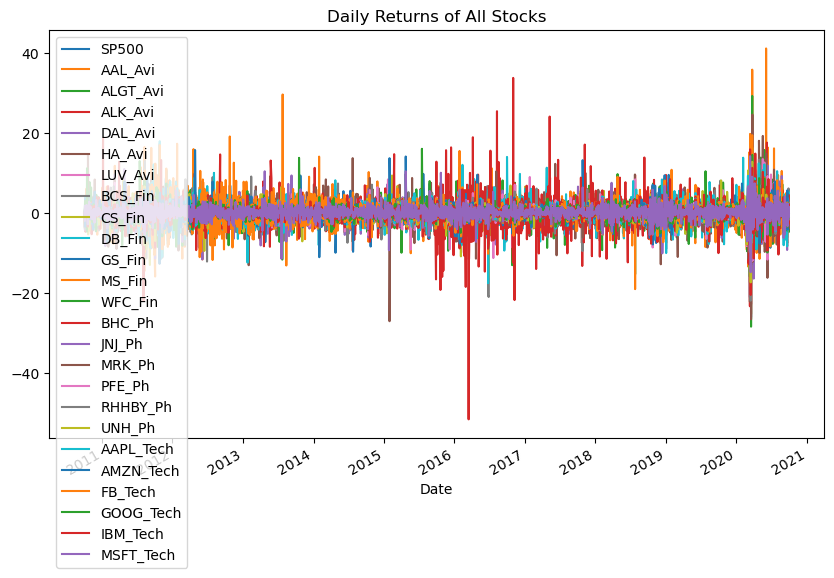

In [ ]:
 # Plotting the series to understand the correlation
daily_returns.plot(figsize = (10,6), title = 'Daily Returns of All Stocks',fontsize = 10)

### Task 2: Stock price dispersion from mean ( Histogram)

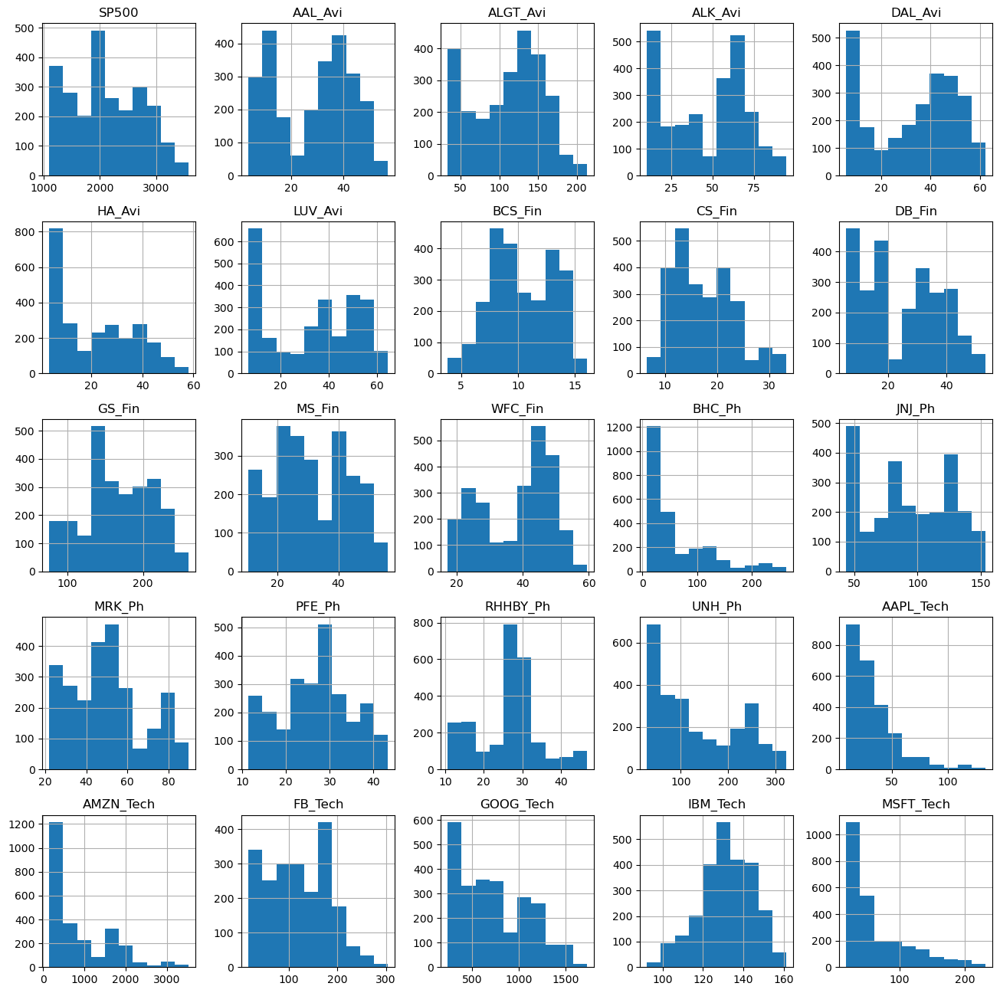

In [ ]:
#Plotting histogram
fig = stocks_price_df.hist(figsize = (16,16))

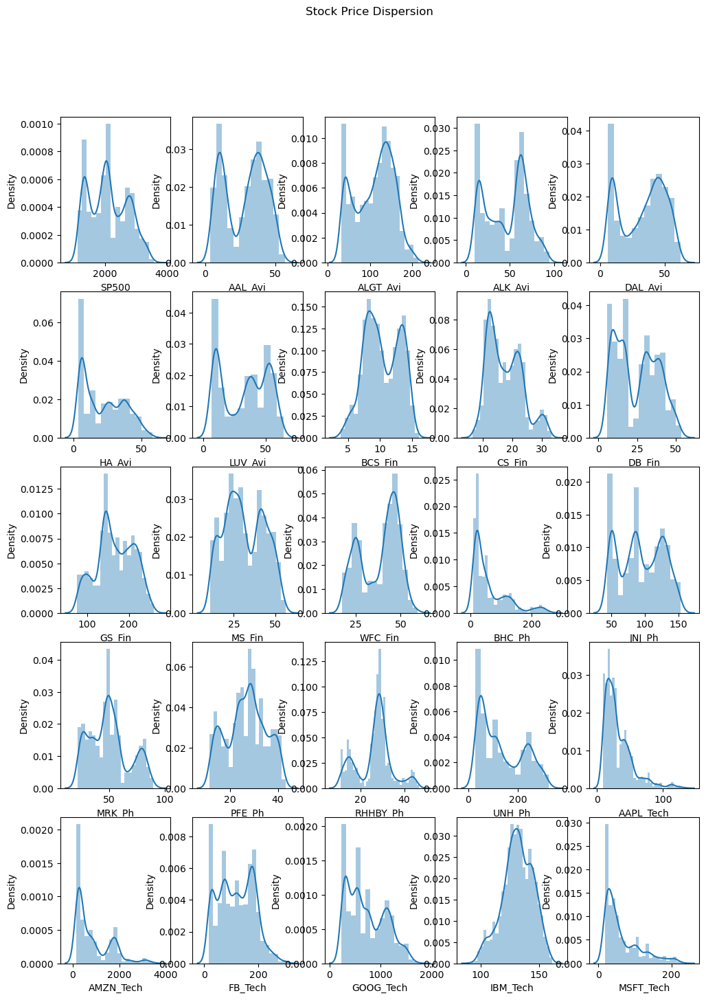

In [ ]:
#plotting the histrogram plots for stock prices
plt.figure(figsize=(12,16))
feature = stocks_price_df.columns

for i in enumerate(feature):
  plt.subplot(5,5,i[0]+1)
  sns.distplot(stocks_price_df[i[1]],hist=True)

plt.suptitle("Stock Price Dispersion")
plt.show()

#### As we can see in the histogram above, AMZN stock is having the highest dispersion from mean where as BCS is having the lowest dispersion from mean. 

### Task 3: Maximum and Minimum price during the specified period


In [ ]:
stocks_price_df.describe()

,SP500,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
count,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2517.000000,2106.000000,2517.000000,2517.000000,2517.000000
mean,2111.392732,28.332638,111.269736,46.889544,33.155697,22.182312,33.181573,10.352270,17.507931,25.029328,166.665287,31.400017,38.214090,61.869178,93.859400,50.180250,26.791005,26.529080,133.891782,31.776725,854.636107,119.599425,730.426139,131.560916,64.329487
std,612.227235,14.712407,44.512322,23.293159,16.962553,14.964163,18.178329,2.716096,5.732890,13.191191,43.999974,11.830537,10.713024,57.177157,31.834527,17.593225,8.129475,7.932497,85.656387,21.162673,745.201139,63.839134,364.685720,12.925159,48.586471
min,1099.229980,3.770966,33.202705,10.242908,5.880505,3.642072,6.838268,3.840000,6.552680,5.480000,76.414085,10.528513,17.346252,8.510000,43.686241,21.931190,11.407802,10.658990,28.966356,8.599421,153.029999,17.730000,236.553345,92.307220,18.943493
25%,1562.170044,12.560000,73.808090,24.650858,14.425889,6.773483,12.362411,8.189272,12.715983,12.953422,139.162918,22.162964,26.737719,22.170000,66.644791,36.045670,21.589884,23.514585,52.314556,16.853184,266.489990,68.429998,403.642059,123.787781,26.457781
50%,2071.219971,31.816221,119.889999,55.455898,36.875954,21.120163,36.273319,9.981655,16.708580,26.462519,164.142197,29.896759,42.076374,38.759998,89.460175,49.284191,27.586123,27.959875,109.161522,25.673811,533.750000,118.680000,651.789978,131.873566,43.276833
75%,2656.300049,40.423805,146.075607,64.511078,47.116314,35.708328,50.840229,12.937257,21.744936,36.699535,204.169312,41.714840,46.810326,90.269997,123.004646,58.247047,32.893768,30.329943,218.130539,41.725651,1500.000000,173.980003,1055.810059,141.419022,90.585373
max,3580.840088,56.988728,213.385254,94.471420,62.263969,58.099716,64.447029,16.075008,33.230030,53.558323,260.138916,56.244881,59.477455,262.519989,153.830002,89.912033,43.265999,46.840000,322.371643,134.179993,3531.449951,303.910004,1728.280029,161.213455,231.649994


In [ ]:
print('Minimum price of each stock during the specified period is:')
stocks_price_df.min()

Minimum price of each stock during the specified period is:


SP500        1099.229980
AAL_Avi         3.770966
ALGT_Avi       33.202705
ALK_Avi        10.242908
DAL_Avi         5.880505
HA_Avi          3.642072
LUV_Avi         6.838268
BCS_Fin         3.840000
CS_Fin          6.552680
DB_Fin          5.480000
GS_Fin         76.414085
MS_Fin         10.528513
WFC_Fin        17.346252
BHC_Ph          8.510000
JNJ_Ph         43.686241
MRK_Ph         21.931190
PFE_Ph         11.407802
RHHBY_Ph       10.658990
UNH_Ph         28.966356
AAPL_Tech       8.599421
AMZN_Tech     153.029999
FB_Tech        17.730000
GOOG_Tech     236.553345
IBM_Tech       92.307220
MSFT_Tech      18.943493
dtype: float64

In [ ]:
print('Maximum price of each stock during the specified period is:')
stocks_price_df.max()

Maximum price of each stock during the specified period is:


SP500        3580.840088
AAL_Avi        56.988728
ALGT_Avi      213.385254
ALK_Avi        94.471420
DAL_Avi        62.263969
HA_Avi         58.099716
LUV_Avi        64.447029
BCS_Fin        16.075008
CS_Fin         33.230030
DB_Fin         53.558323
GS_Fin        260.138916
MS_Fin         56.244881
WFC_Fin        59.477455
BHC_Ph        262.519989
JNJ_Ph        153.830002
MRK_Ph         89.912033
PFE_Ph         43.265999
RHHBY_Ph       46.840000
UNH_Ph        322.371643
AAPL_Tech     134.179993
AMZN_Tech    3531.449951
FB_Tech       303.910004
GOOG_Tech    1728.280029
IBM_Tech      161.213455
MSFT_Tech     231.649994
dtype: float64

### Task 4: Find  Risk/Volatality 

In [ ]:
# Calculate the standard deviation of  daily returns for each stock
daily_returns.std()

# Calculate the risk/volatility returns for each stock)

volatility = daily_returns.std()*252**.5

# Print the volatility of each stock
print('Risk/Volatility of each stock is:')
print(volatility)

Risk/Volatility of each stock is:
SP500        17.353996
AAL_Avi      51.935706
ALGT_Avi     39.009253
ALK_Avi      37.404590
DAL_Avi      40.517595
HA_Avi       47.847027
LUV_Avi      32.500219
BCS_Fin      40.038252
CS_Fin       35.131653
DB_Fin       41.804976
GS_Fin       29.085662
MS_Fin       35.987341
WFC_Fin      28.641587
BHC_Ph       56.665057
JNJ_Ph       17.157938
MRK_Ph       20.649425
PFE_Ph       19.939295
RHHBY_Ph     21.068154
UNH_Ph       26.071160
AAPL_Tech    28.100922
AMZN_Tech    31.567260
FB_Tech      34.221001
GOOG_Tech    25.850967
IBM_Tech     22.393911
MSFT_Tech    25.527551
dtype: float64


### Task 5 : Correlation analysis of daily returns among the stocks ( within the industry group and overall )


<AxesSubplot:>

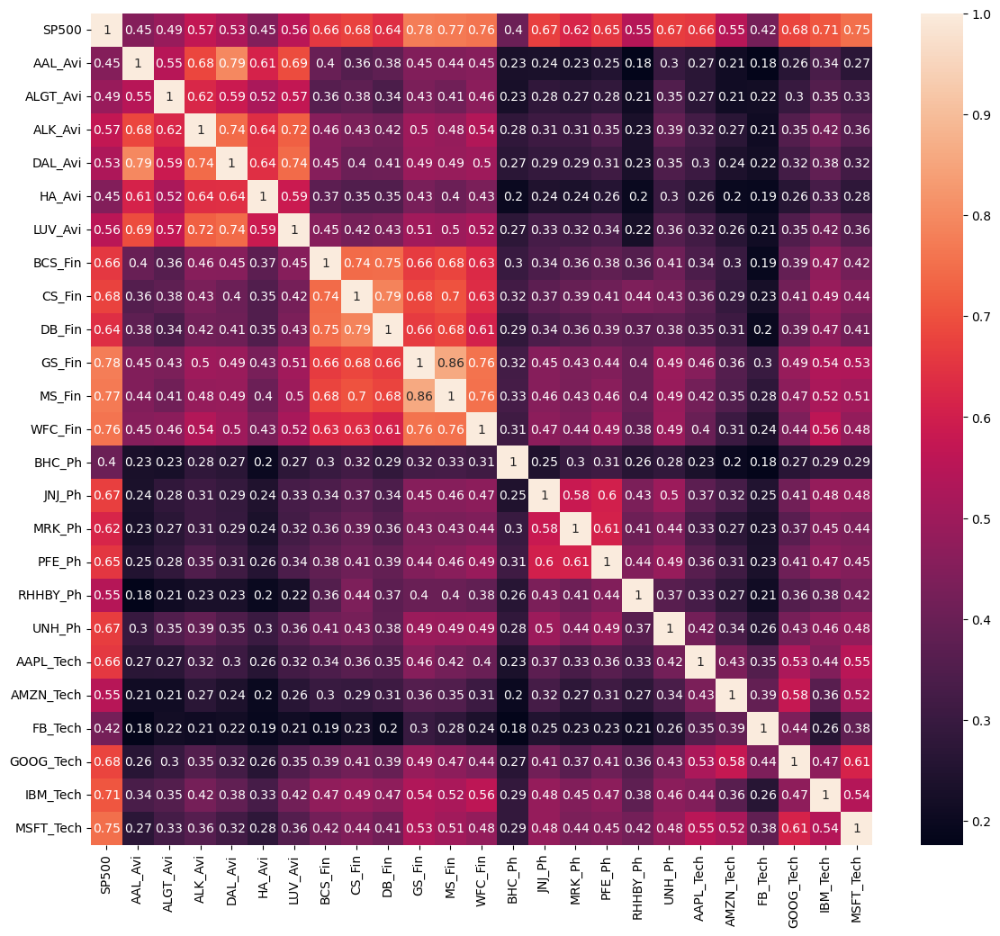

In [ ]:
# Daily Return Correlation
cm = daily_returns.corr()

plt.figure(figsize=(14, 12))
ax = plt.subplot()
sns.heatmap(cm, annot = True, ax = ax)

#### 
As we can see in the stock prices heatmap above, Finance sector stocks are highly correlated the S&P500 index. MSFT and IBM  is also having a highl correlation with market. Among the pharma sector stocks, JNJ and UNH are having the highest correlation with market. Pharma sector stock BHC is having the least correlation with the market.

From aviation sector, DAL is highly correlated with AAL and ALK stocks. Among the pharma sector stocks, PFE and MRK have the highest correlation. From Finance sector stocks, MS is having highest correlation of 0.86 with GS.
Among technology sector stocks, GOOG and MSFT have high correlation. 

<AxesSubplot:>

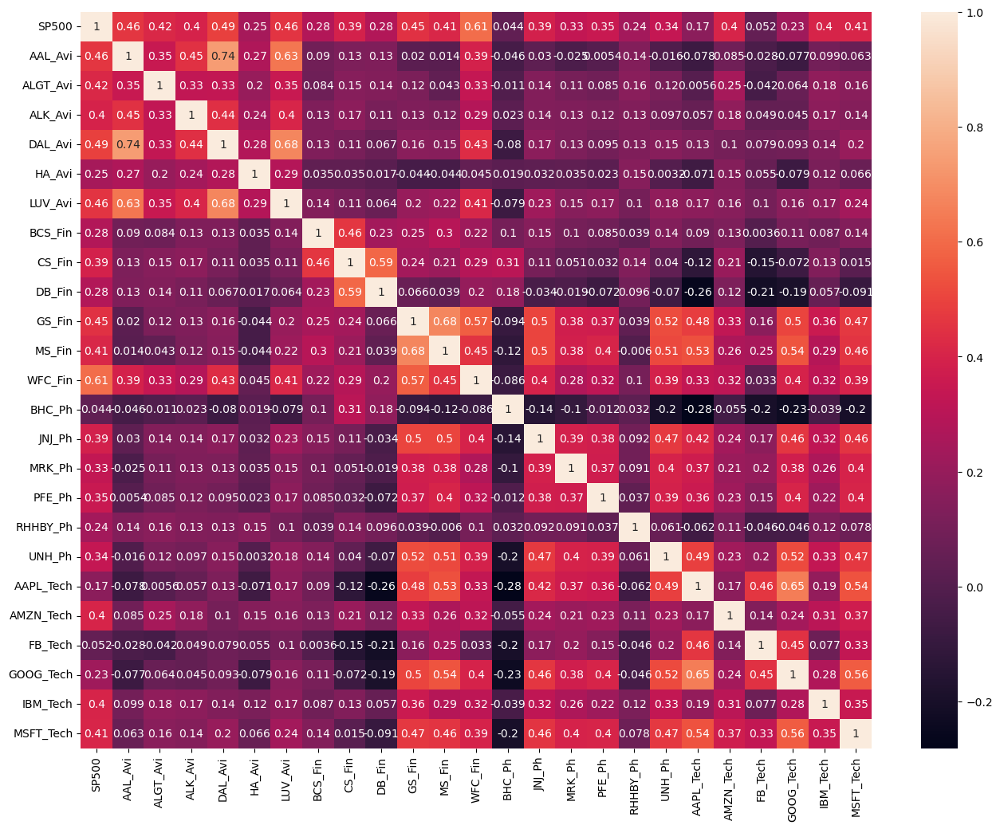

In [ ]:
# Volume Correlation
cm = stocks_volume_df.corr()

plt.figure(figsize=(16, 12))
ax = plt.subplot()
sns.heatmap(cm, annot = True, ax = ax)

#### As we can see that Aviation sector stock AAL is having strong correlation with DAL. GOOG stock is also having a strong correlation with AAPL stock. LUV stock is also having strong correlation with AAL and DAL. WFC stock is having strong correlation with SP500.

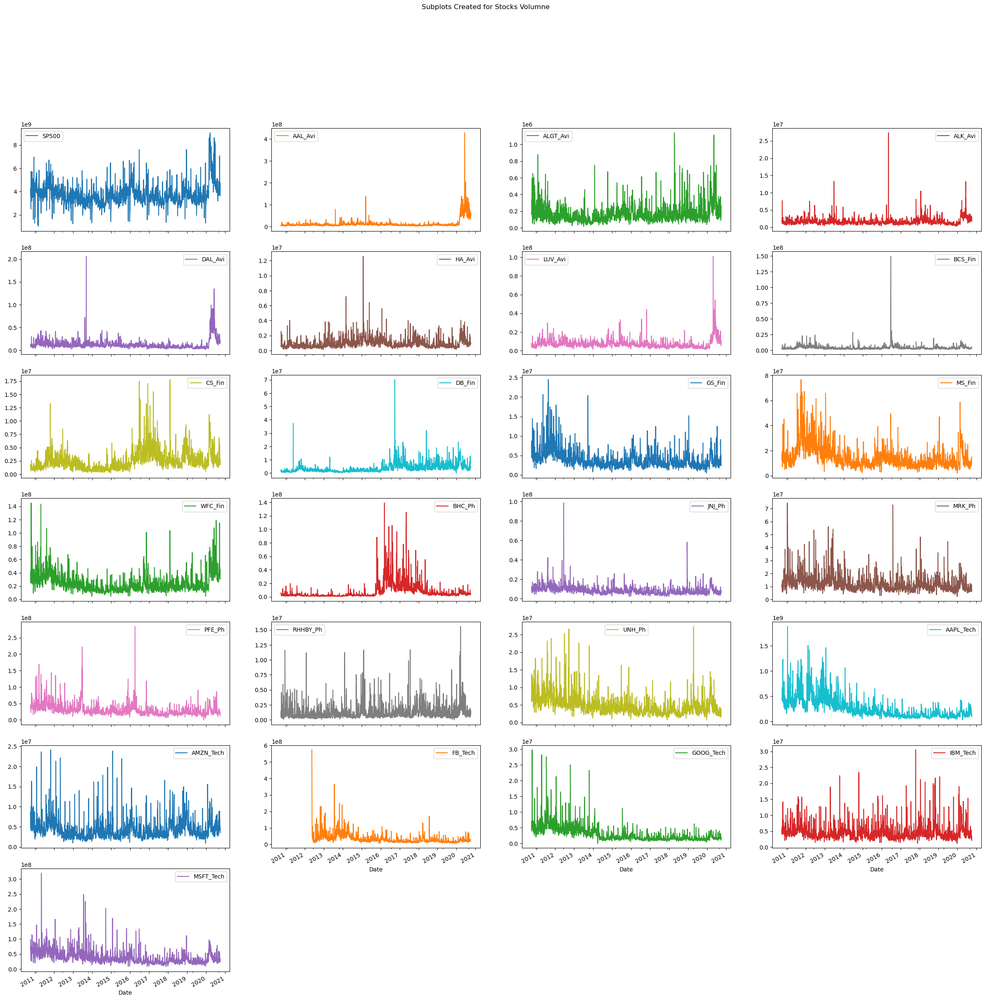

In [ ]:
#creating sub plots for stocks volume
stocks_volume_df.plot(kind='line',subplots=True,layout=(7,4),figsize=(30,30))
plt.suptitle("Subplots Created for Stocks Volumne")
plt.show()

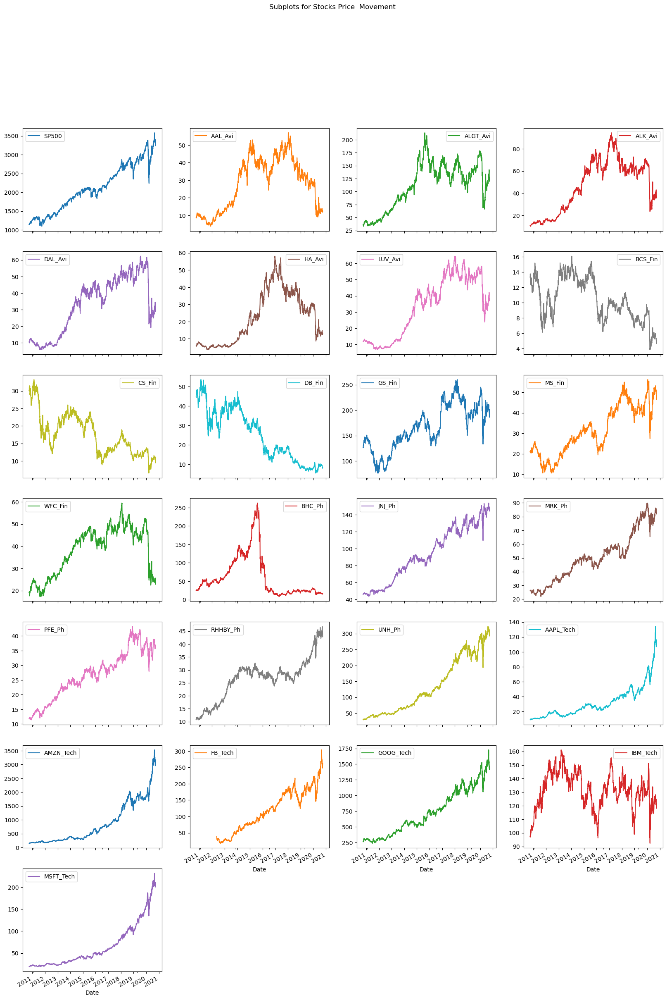

In [ ]:
#creating subplot for Stocks Price movement
stocks_price_df.plot(kind='line',subplots=True,layout=(7,4),figsize=(20,30))
plt.suptitle("Subplots for Stocks Price  Movement")
plt.show()

### Task: Visulisations of stock prices with and without normalization 

In [ ]:
# Define a function to plot the entire dataframe
# The function takes in a dataframe df as an input argument and does not return anything back!
# The function performs data visualization

def show_plot(df, fig_title):
  df.plot(x= df.index, figsize = (15,7), linewidth = 3, title = fig_title)
  plt.grid()
  plt.show()

In [ ]:
# Function to perform an interactive data plotting using plotly express
# Plotly.express module which is imported as px includes functions that can plot interactive plots easily and effectively. 
# Every Plotly Express function uses graph objects internally and returns a plotly.graph_objects.Figure instance. 

def interactive_plot(df, title):
  fig = px.line(title = title)
  
  # Loop through each stock (while ignoring time columns with index 0)
  for i in df.columns[:]:
    fig.add_scatter(x = df.index, y = df[i], name = i) # add a new Scatter trace

  fig.show()

#### Task 6: Visulisation of non-normalized stock prices

In [ ]:
# Plot interactive chart of non-normalized prices of all the stocks
interactive_plot(stocks_price_df, 'Non-Normalized Prices of All The Stocks')

### Task 7: Visulazation of normalized prices of the stocks

In [ ]:
# Function to normalize the prices based on the initial price
def normalize(df):
  x = df.copy()
  for i in x.columns[:]:
    x[i] = x[i]/x[i][0]
  return x

In [ ]:
# Normalizing the stock price dataframe
stocks_price_normalized_df= normalize(stocks_price_df)

In [ ]:
# Checking the dataframe
stocks_price_normalized_df.head()

,SP500,AAL_Avi,ALGT_Avi,ALK_Avi,DAL_Avi,HA_Avi,LUV_Avi,BCS_Fin,CS_Fin,DB_Fin,GS_Fin,MS_Fin,WFC_Fin,BHC_Ph,JNJ_Ph,MRK_Ph,PFE_Ph,RHHBY_Ph,UNH_Ph,AAPL_Tech,AMZN_Tech,FB_Tech,GOOG_Tech,IBM_Tech,MSFT_Tech
Date,,,,,,,,,,,,,,,,,,,,,,,,,
2010-10-01,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,NaN,1.000000,1.000000,1.000000
2010-10-04,0.991965,0.981701,0.962063,0.975497,0.958368,0.964765,0.990726,0.994241,0.992599,0.984035,0.992350,0.987610,0.992958,1.004660,0.998704,0.997814,0.983702,0.993387,0.974880,0.986267,1.010930,NaN,0.993779,0.997125,0.980722
2010-10-05,1.012659,0.993542,0.973861,0.981321,0.985012,0.981543,1.006183,1.031413,1.021970,1.025762,1.012661,1.017986,1.026995,1.021359,1.017004,1.011475,1.002911,1.023577,0.989839,1.022724,1.046581,NaN,1.023991,1.014892,0.998770
2010-10-06,1.011978,0.993542,0.970391,0.979112,0.980849,1.001678,1.000000,1.019372,1.028677,1.038280,1.021259,1.014388,1.028951,1.036505,1.023644,1.011202,1.004657,1.033640,0.958228,1.023609,1.010995,NaN,1.016609,1.016220,1.002051
2010-10-07,1.010312,0.994618,0.964608,0.933923,0.980017,1.031879,0.995363,0.980104,1.034228,1.027395,1.023088,1.001999,1.017215,1.033010,1.023806,1.003005,1.011641,1.031052,0.969235,1.023715,1.016655,NaN,1.008352,1.022707,1.006153


#### Plotting the normalized prices of aviation sector stocks against the S&P500 Index

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

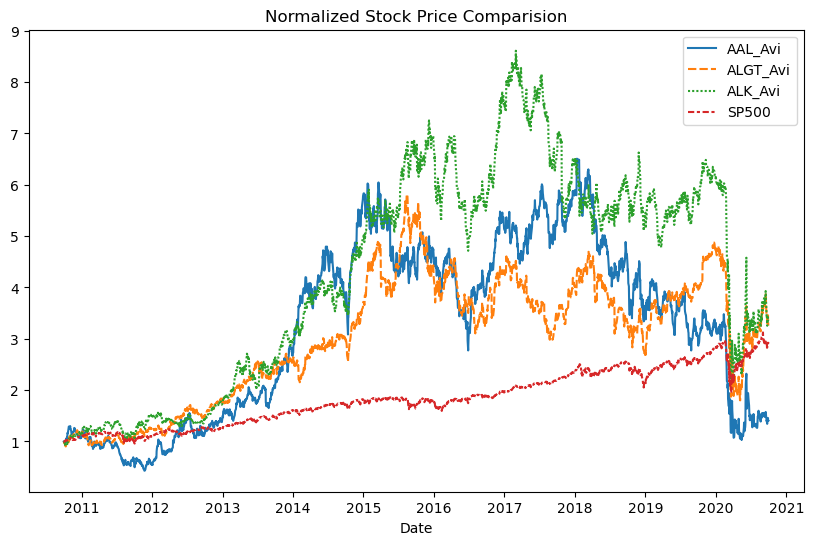

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['AAL_Avi','ALGT_Avi','ALK_Avi','SP500']])


<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

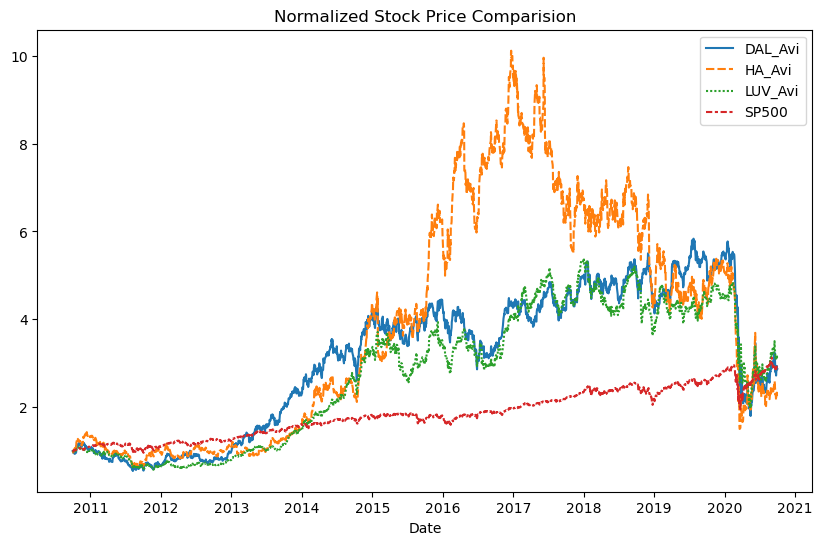

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['DAL_Avi','HA_Avi', 'LUV_Avi', 'SP500']])

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

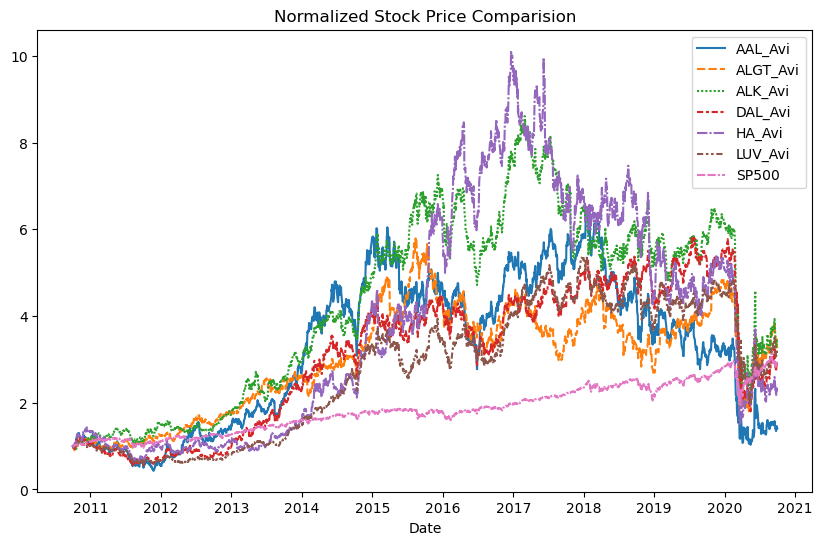

In [ ]:
# Comparing all aviation  sector stocks with S&P500
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[[ 'AAL_Avi','ALGT_Avi','ALK_Avi' ,'DAL_Avi','HA_Avi', 'LUV_Avi','SP500']])

#### Plotting normalized prices of Finance Sector stocks with S&P500 Index

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

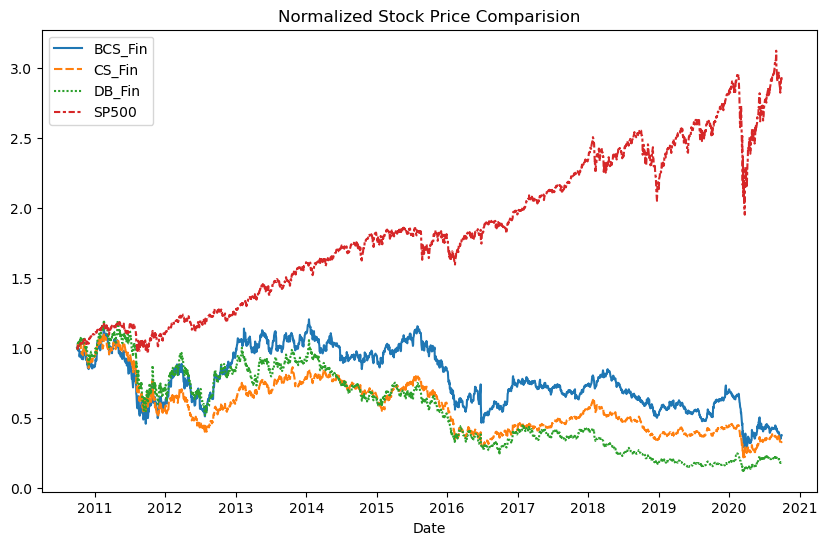

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['BCS_Fin','CS_Fin','DB_Fin','SP500']])

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

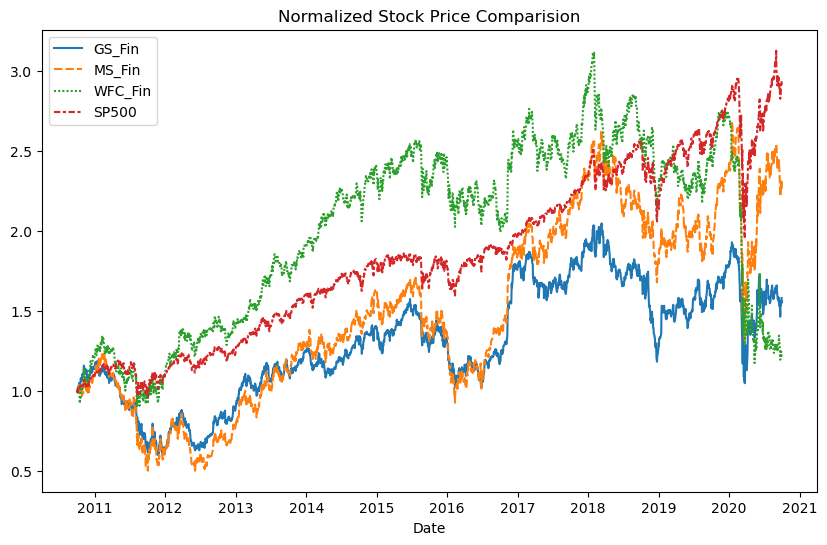

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['GS_Fin','MS_Fin','WFC_Fin','SP500']])

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

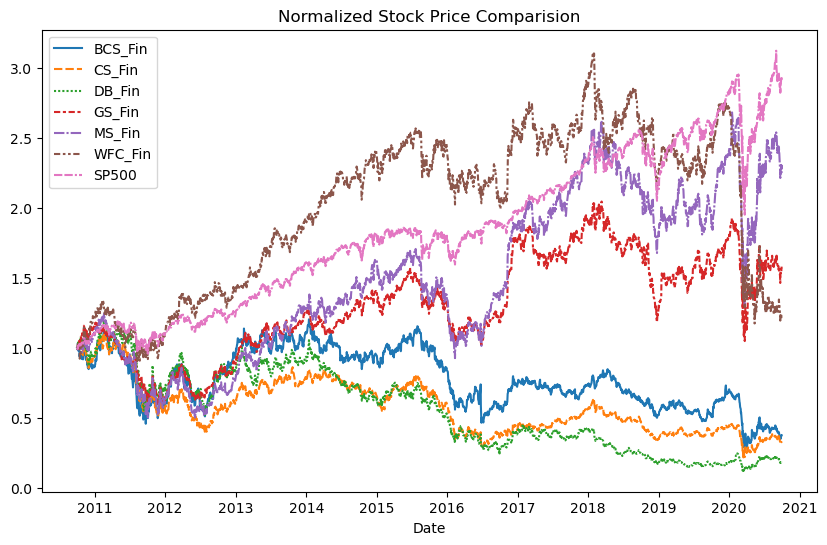

In [ ]:
# Comparing stocks of finance sector against each other and S&P500 index
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['BCS_Fin','CS_Fin','DB_Fin','GS_Fin','MS_Fin','WFC_Fin','SP500']])

### Plotting normalized prices of Pharma Sector stocks with S&P500 Index

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

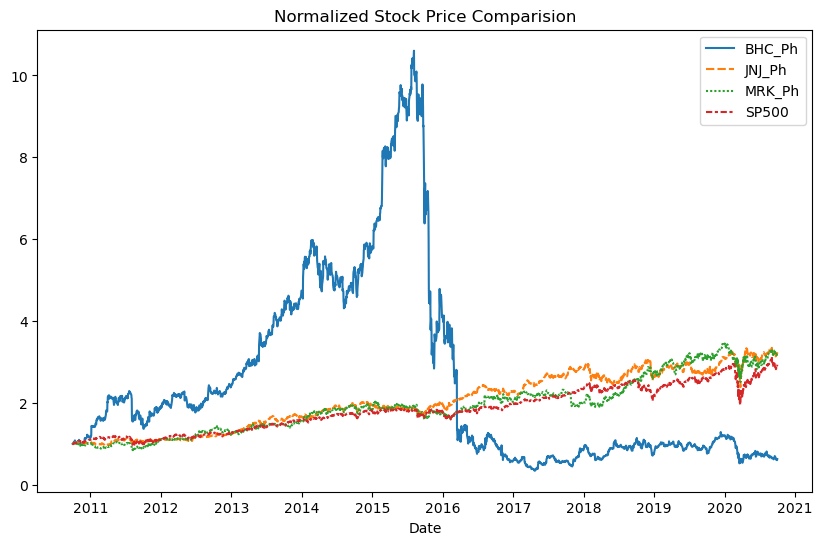

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['BHC_Ph','JNJ_Ph','MRK_Ph','SP500']])

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

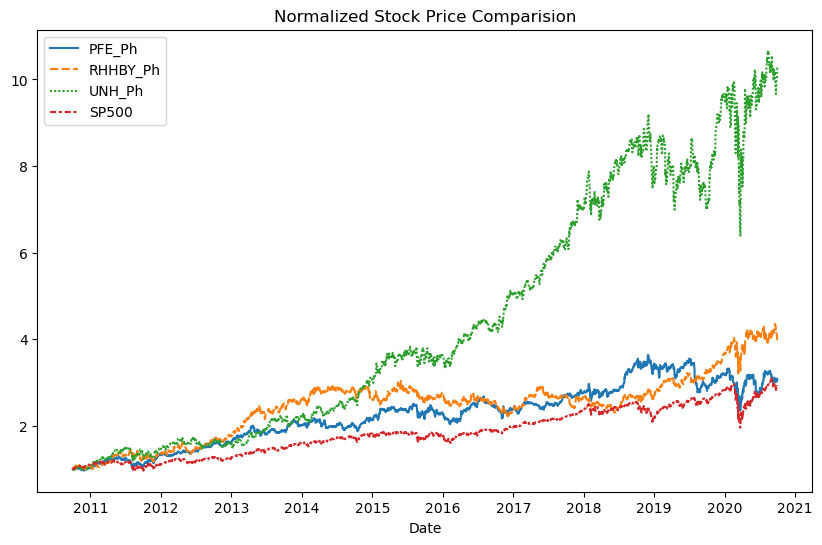

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['PFE_Ph','RHHBY_Ph','UNH_Ph','SP500']])

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

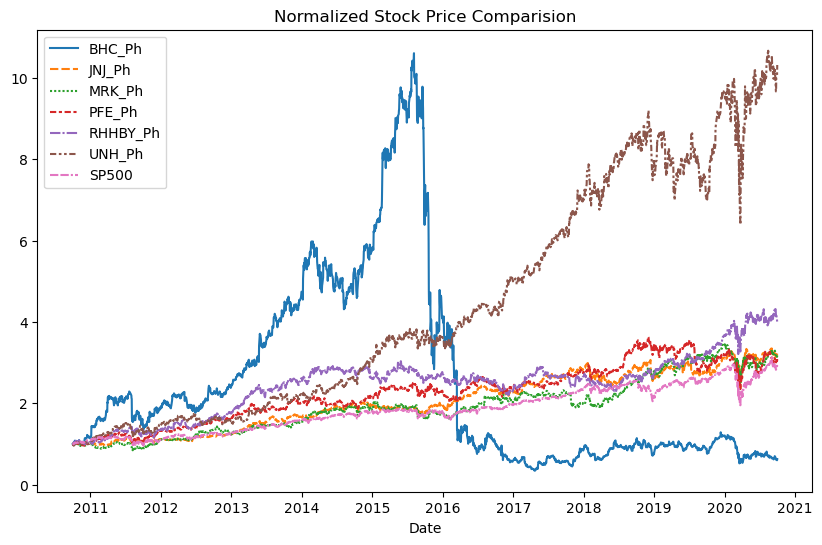

In [ ]:
# Comparing stocks of finance sector against each other and S&P500 index
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['BHC_Ph','JNJ_Ph','MRK_Ph','PFE_Ph','RHHBY_Ph','UNH_Ph','SP500']])

### Plotting normalized prices of Technology Sector stocks with S&P500 Index

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

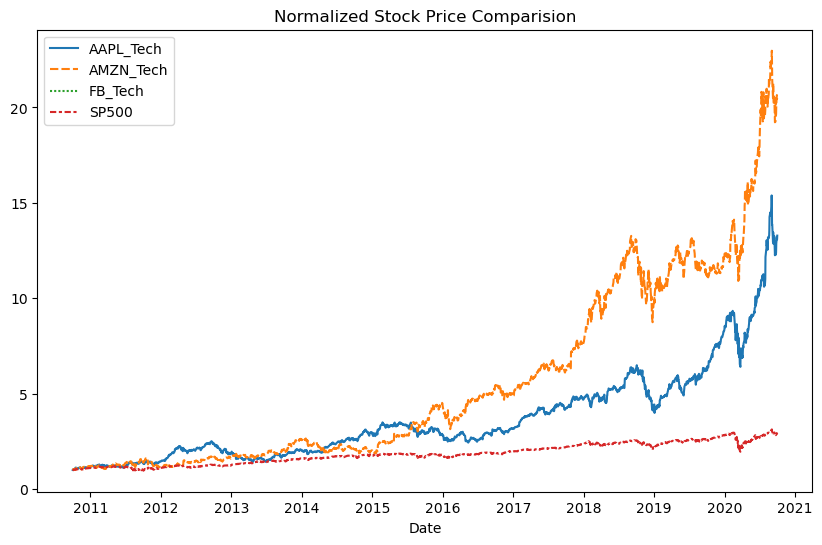

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['AAPL_Tech','AMZN_Tech','FB_Tech','SP500']])

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

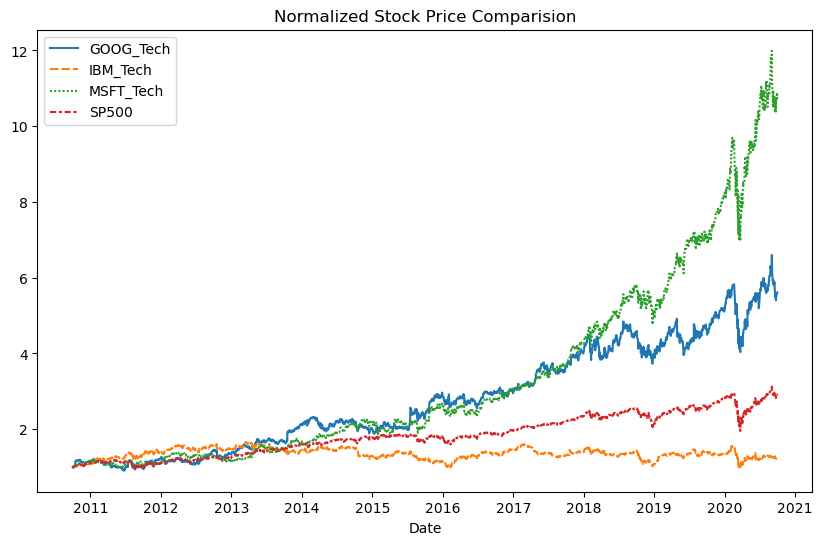

In [ ]:
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['GOOG_Tech','IBM_Tech','MSFT_Tech','SP500']])

<AxesSubplot:title={'center':'Normalized Stock Price Comparision'}, xlabel='Date'>

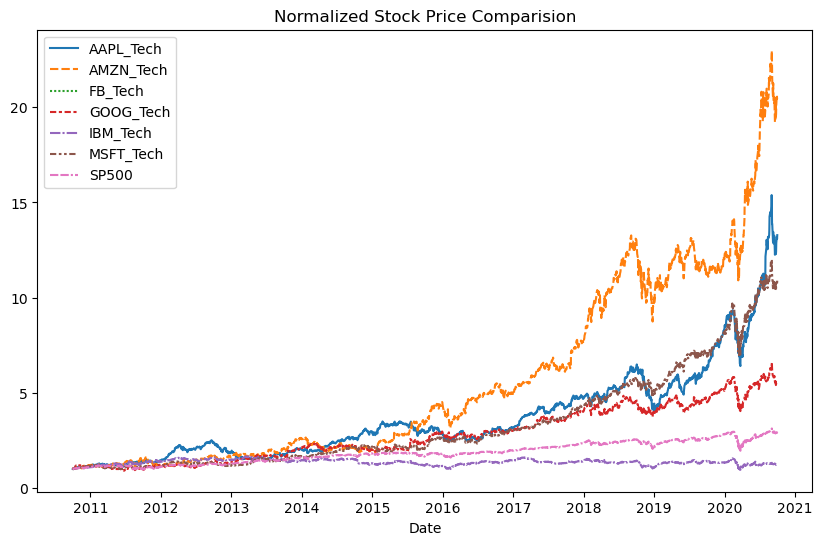

In [ ]:
# Comparing stocks of technology sector against each other and S&P500 index
plt.figure(figsize=(10,6))
plt.title('Normalized Stock Price Comparision')
sns.lineplot(data = stocks_price_normalized_df[['AAPL_Tech','AMZN_Tech','FB_Tech','GOOG_Tech','IBM_Tech','MSFT_Tech','SP500']])

In [ ]:
# Plot interactive chart of normalized prices of all the stocks
interactive_plot(stocks_price_normalized_df, 'Normalized Prices of All The Stocks')

### Task 3:  SELECTION OF RELEVANT STOCKS USING CAPM:
        a. VISUALIZE THE DAILY RETURN OF EACH STOCK VIS-A-VIS MARKET RETURNS( USE SP5OO INDEX AS MARKET RETURN) BY USING SCATTER PLOTS.
        b. CALCULATE BETA VALUE FOR EACH STOCK
        c. DETERMINE THE EXPECTED RETURN FOR EACH STOCK USING CAPM MODEL ( NOTE: USE 0.75% AS RISK-FREE RATE BASED ON 10-YEAR US TREASURY BOND YIELD)
        d. ESTIMATE THE PORTFOLIO RETURNS USING THE CAPM FORMULA (NOTE: USE EQUAL WEIGHTS FOR THE STOCKS FOR THE PORTFOLIO INVESTMENT AMOUNT IS UNKNOWN)
        e. COMPARE AND COMMENT ON THE RESULTS AND FINDINGS FOR EVERY STOCK


### Task A : Visualize the daily return of each stock vis-a-vis market returns

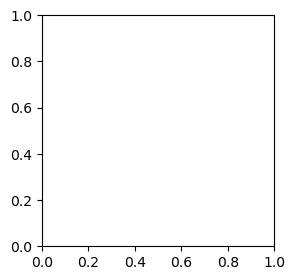

In [ ]:
# Define plot space
fig, ax = plt.subplots(figsize=(3, 3))

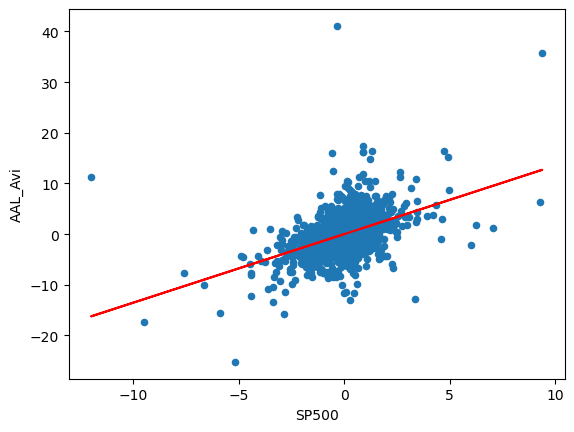

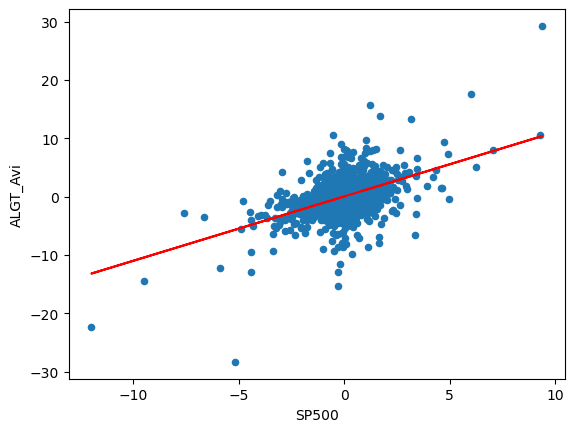

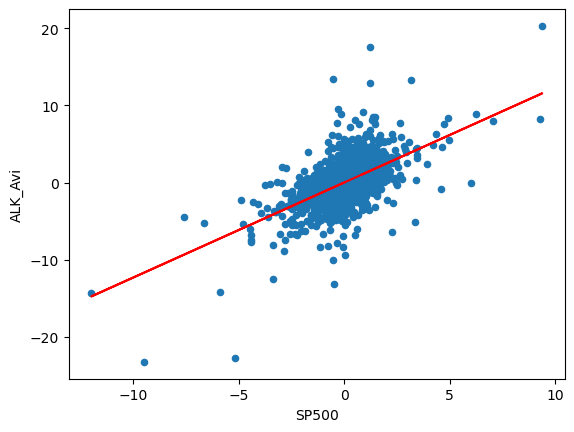

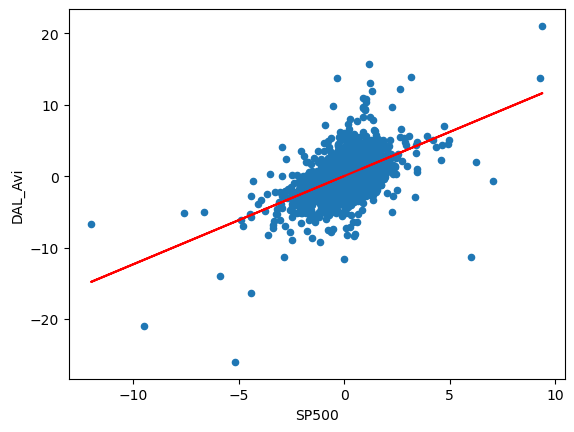

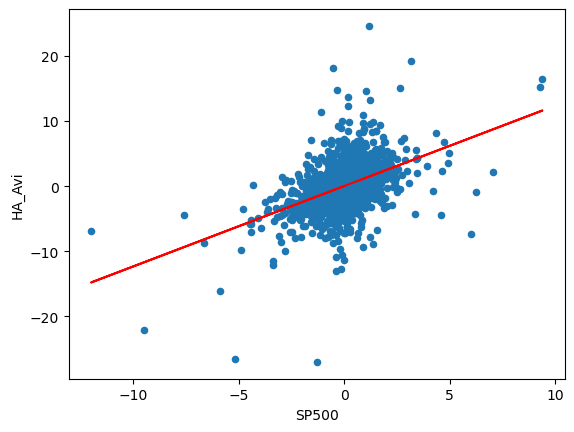

...

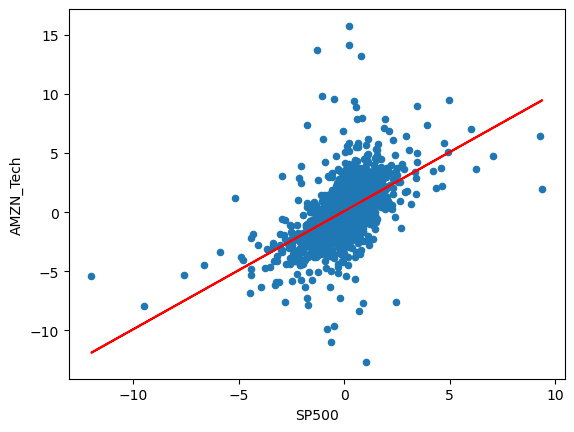

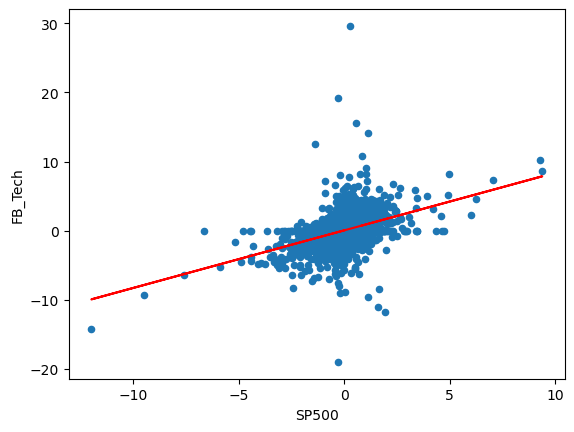

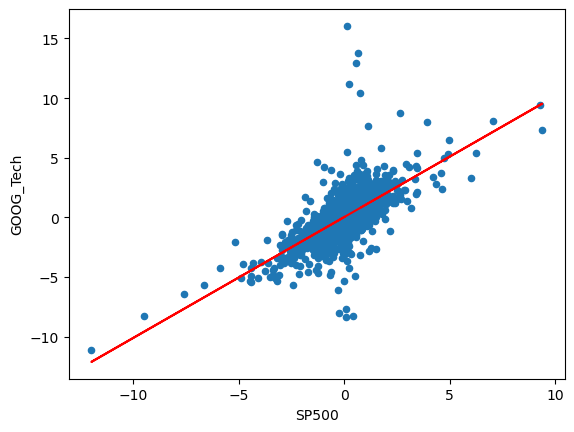

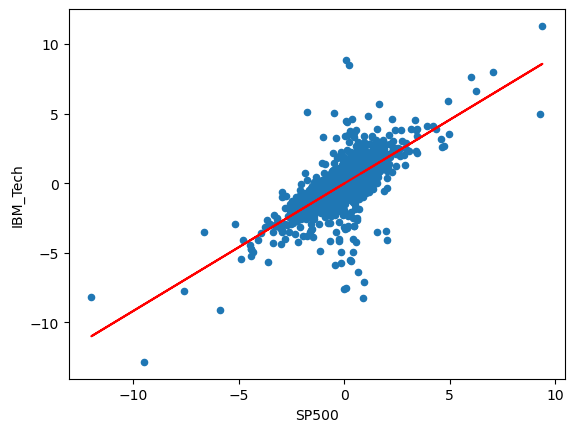

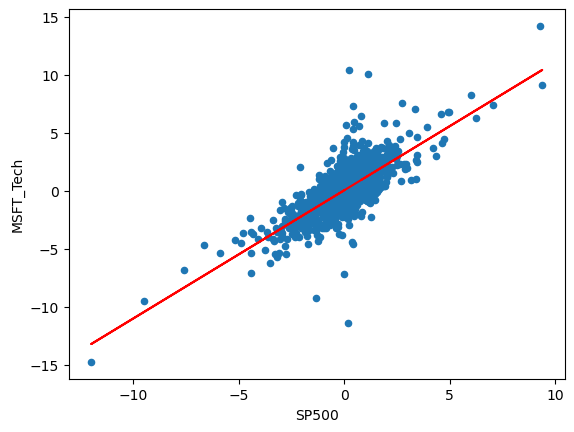

In [ ]:
# Let's create a placeholder for all betas and alphas (empty dictionaries)
beta = {}
alpha = {}


# Loop on every stock daily return
for i in daily_returns.columns:
    
  # Ignoring the  SP500 Column
  if i != 'SP500':
    # plot a scatter plot between each individual stock and the S&P500 (Market)
    daily_returns.plot(kind = 'scatter', x = 'SP500', y = i)
    
    # Fit a polynomial between each stock and the S&P500 (Poly with order = 1 is a straight line)
    b, a = np.polyfit(daily_returns['SP500'], daily_returns[i], 1)
    
    plt.plot(daily_returns['SP500'], b * daily_returns['SP500'] + a, '-', color = 'r')
    
    beta[i] = b
    
    alpha[i] = a
    
    plt.savefig('plot.png', dpi=300, bbox_inches='tight')
    plt.show()

In [ ]:
# Interactive Scatter plot


for i in daily_returns.columns:
  
  if i != 'SP500':
    
    # Use plotly express to plot the scatter plot for every stock vs. the S&P500
    fig = px.scatter(daily_returns, x = 'SP500', y = i, title = i)

    # Fit a straight line to the data and obtain beta and alpha
    b, a = np.polyfit(daily_returns['SP500'], daily_returns[i], 1)
    
    # Plot the straight line 
    fig.add_scatter(x = daily_returns['SP500'], y = b*daily_returns['SP500'] + a)
    
    fig.show()

### Task B: Calculate Beta value for each stock


In [ ]:
# printing beta values calculated in the previous operation
beta

{'AAL_Avi': 1.3533142402422795,
 'ALGT_Avi': 1.1028230480803756,
 'ALK_Avi': 1.2319674374455862,
 'DAL_Avi': 1.2348354908656045,
 'HA_Avi': 1.2339237830114362,
 'LUV_Avi': 1.0403638313220092,
 'BCS_Fin': 1.513319246062038,
 'CS_Fin': 1.372706087267458,
 'DB_Fin': 1.5358266706864732,
 'GS_Fin': 1.3014746298336477,
 'MS_Fin': 1.5979441231943459,
 'WFC_Fin': 1.2537507780917048,
 'BHC_Ph': 1.316482662171336,
 'JNJ_Ph': 0.663955521396161,
 'MRK_Ph': 0.7366364496836757,
 'PFE_Ph': 0.7506813446423024,
 'RHHBY_Ph': 0.6624148127873533,
 'UNH_Ph': 1.0007858342005553,
 'AAPL_Tech': 1.0631120455363277,
 'AMZN_Tech': 0.9988037994741075,
 'FB_Tech': 0.8326927257659115,
 'GOOG_Tech': 1.0133385544703526,
 'IBM_Tech': 0.916299764864777,
 'MSFT_Tech': 1.105252498450272}

In [ ]:
# printing alpha values calculated in the previous operation
alpha

{'AAL_Avi': -1.523446504784857e-05,
 'ALGT_Avi': 0.02366184275462965,
 'ALK_Avi': 0.015855681761771583,
 'DAL_Avi': 0.01445339803461875,
 'HA_Avi': 0.017776321226864424,
 'LUV_Avi': 0.015502852896433467,
 'BCS_Fin': -0.0805583122258871,
 'CS_Fin': -0.08624680159331259,
 'DB_Fin': -0.10691801054069022,
 'GS_Fin': -0.028496066414088448,
 'MS_Fin': -0.01910914750187258,
 'WFC_Fin': -0.036583915499699665,
 'BHC_Ph': -0.01624134047451558,
 'JNJ_Ph': 0.02016466563123944,
 'MRK_Ph': 0.01853935102746801,
 'PFE_Ph': 0.016025224643760425,
 'RHHBY_Ph': 0.03131641487237049,
 'UNH_Ph': 0.05745047006915158,
 'AAPL_Tech': 0.06664750392128281,
 'AMZN_Tech': 0.09098857805438325,
 'FB_Tech': 0.05882982097636516,
 'GOOG_Tech': 0.03229558653658255,
 'IBM_Tech': -0.02575411131194939,
 'MSFT_Tech': 0.053926037966155395}

In [ ]:
# Calculating the average daily rate of return for S&P500
daily_returns['SP500'].mean()

0.04877662315346994

In [ ]:
# Let's calculate the annualized rate of return for S&P500 which is also called the market return
 
# Check your answers with: https://dqydj.com/sp-500-return-calculator/
rm = daily_returns['SP500'].mean() * 252
rm = rm
print('The annual market return is {} %'.format(rm))

The annual market return is 12.291709034674426 %


In [ ]:
# Obtain a list of all stock names
keys = list(beta.keys())
keys

['AAL_Avi',
 'ALGT_Avi',
 'ALK_Avi',
 'DAL_Avi',
 'HA_Avi',
 'LUV_Avi',
 'BCS_Fin',
 'CS_Fin',
 'DB_Fin',
 'GS_Fin',
 'MS_Fin',
 'WFC_Fin',
 'BHC_Ph',
 'JNJ_Ph',
 'MRK_Ph',
 'PFE_Ph',
 'RHHBY_Ph',
 'UNH_Ph',
 'AAPL_Tech',
 'AMZN_Tech',
 'FB_Tech',
 'GOOG_Tech',
 'IBM_Tech',
 'MSFT_Tech']

### Task C: DETERMINE THE EXPECTED RETURN FOR EACH STOCK USING CAPM MODEL

In [ ]:
# Defining the expected return dictionary
ER = {}

rf = 0.75  # Taking  risk free rate = 0.75 as instructed in the problem definition

for i in keys:
  # Calculate return for every security using CAPM  
  ER[i] = rf + ( beta[i] * (rm - rf) ) 

In [ ]:
# Printing expected returns based on CAPM
for i in keys:
  print('Expected Return Based on CAPM for {} over the given  10 years duration is {}%'.format(i, ER[i]))

Expected Return Based on CAPM for AAL_Avi over the given  10 years duration is 16.369559193357873%
Expected Return Based on CAPM for ALGT_Avi over the given  10 years duration is 13.478462737676459%
Expected Return Based on CAPM for ALK_Avi over the given  10 years duration is 14.969009703190423%
Expected Return Based on CAPM for DAL_Avi over the given  10 years duration is 15.002111941260177%
Expected Return Based on CAPM for HA_Avi over the given  10 years duration is 14.99158927448274%
Expected Return Based on CAPM for LUV_Avi over the given  10 years duration is 12.757576631317734%
Expected Return Based on CAPM for BCS_Fin over the given  10 years duration is 18.216290414620914%
Expected Return Based on CAPM for CS_Fin over the given  10 years duration is 16.5933742493674%
Expected Return Based on CAPM for DB_Fin over the given  10 years duration is 18.47606456075601%
Expected Return Based on CAPM for GS_Fin over the given  10 years duration is 15.771241493550566%
Expected Return B

In [ ]:
# Stocks having negative returns
negative_return_stocks = []
for i in keys:
    if (ER[i] < 0): 
        negative_return_stocks.append(i)
        print('Expected Return Based on CAPM for {} is {}%'.format(i, ER[i]))

In [ ]:
# printing list of stocks having negative returns
negative_return_stocks


[]

#### So there are no stocks with negative returns

#### TASK D : ESTIMATE THE PORTFOLIO RETURNS USING THE CAPM FORMULA (NOTE: USE EQUAL WEIGHTS FOR THE STOCKS FOR THE PORTFOLIO INVESTMENT AMOUNT IS UNKNOWN)

In [ ]:
# Assuming equal weights in the portfolio
portfolio_weights = 1/24 * np.ones(24) # considering 24 stocks given
portfolio_weights

array([0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04,
       0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04, 0.04,
       0.04, 0.04])

In [ ]:
# Calculating the portfolio return 
ER_portfolio = sum(list(ER.values()) * portfolio_weights)
ER_portfolio

13.653969920994342

In [ ]:
print('Expected Return Based on CAPM for the portfolio for the  given duration of 1st October,2010 to 30th September, 2020 is {} %\n'.format(ER_portfolio))

Expected Return Based on CAPM for the portfolio for the  given duration of 1st October,2010 to 30th September, 2020 is 13.653969920994342 %



In [ ]:
#computing Annualized returns
Annual_returns=[]
col=[]

for i in daily_returns.columns:
  col.append(i)

for i in daily_returns.columns:
  Annual_returns.append(daily_returns[i].mean()*252)

In [ ]:
# Creating a dataframe and stocks values for each stock
Annual_details_df=pd.DataFrame(list(zip(col,Annual_returns)),columns=['Stocks','Annualized Returns(%)'])

In [ ]:
#checking the new dataframe
Annual_details_df.head(25)

,Stocks,Annualized Returns(%)
0,SP500,12.291709
1,AAL_Avi,16.630706
2,ALGT_Avi,19.518364
3,ALK_Avi,19.138617
4,DAL_Avi,18.820495
5,HA_Avi,19.646665
6,LUV_Avi,16.694568
7,BCS_Fin,-1.699415
8,CS_Fin,-4.861290
9,DB_Fin,-8.065404


In [ ]:
volatility

SP500        17.353996
AAL_Avi      51.935706
ALGT_Avi     39.009253
ALK_Avi      37.404590
DAL_Avi      40.517595
HA_Avi       47.847027
LUV_Avi      32.500219
BCS_Fin      40.038252
CS_Fin       35.131653
DB_Fin       41.804976
GS_Fin       29.085662
MS_Fin       35.987341
WFC_Fin      28.641587
BHC_Ph       56.665057
JNJ_Ph       17.157938
MRK_Ph       20.649425
PFE_Ph       19.939295
RHHBY_Ph     21.068154
UNH_Ph       26.071160
AAPL_Tech    28.100922
AMZN_Tech    31.567260
FB_Tech      34.221001
GOOG_Tech    25.850967
IBM_Tech     22.393911
MSFT_Tech    25.527551
dtype: float64

In [ ]:
# Appending Annualised Risk/Volatility  that has been calcucalated ealier
Annual_details_df['Annualized Risk/Volatility']=Annual_details_df['Stocks'].map(volatility)


In [ ]:
# checking the new dataframe
Annual_details_df.head(25)

,Stocks,Annualized Returns(%),Annualized Risk/Volatility
0,SP500,12.291709,17.353996
1,AAL_Avi,16.630706,51.935706
2,ALGT_Avi,19.518364,39.009253
3,ALK_Avi,19.138617,37.404590
4,DAL_Avi,18.820495,40.517595
5,HA_Avi,19.646665,47.847027
6,LUV_Avi,16.694568,32.500219
7,BCS_Fin,-1.699415,40.038252
8,CS_Fin,-4.861290,35.131653
9,DB_Fin,-8.065404,41.804976


#### As we see in the above table,  for the Aviation Industry  risks are high but the returns are also better than  the market return rm.  Stocks like BCS, CS and DB are giving negative annual return and are very risky too. AMZN stock is is giving the highest annual return of 35.20%. Apart from IBM, all other technology sector stocks are giving very high annual return. All pharma sector stocks other than RHHBY are offering return near to market return and less risky.


In [ ]:
# Appending the already calculated Expected Returns (ER) as per CAPM to the Annual_details_df dataframe
 
Annual_details_df['Expected Returns(%) as per CAPM']=Annual_details_df['Stocks'].map(ER)

#Annual_details_df['Expected Returns as per CAPM']= rm
        

In [ ]:
Annual_details_df=Annual_details_df.round(2)
Annual_details_df.head(25)

,Stocks,Annualized Returns(%),Annualized Risk/Volatility,Expected Returns(%) as per CAPM
0,SP500,12.29,17.35,NaN
1,AAL_Avi,16.63,51.94,16.37
2,ALGT_Avi,19.52,39.01,13.48
3,ALK_Avi,19.14,37.40,14.97
4,DAL_Avi,18.82,40.52,15.00
5,HA_Avi,19.65,47.85,14.99
6,LUV_Avi,16.69,32.50,12.76
7,BCS_Fin,-1.70,40.04,18.22
8,CS_Fin,-4.86,35.13,16.59
9,DB_Fin,-8.07,41.80,18.48


In [ ]:
# Computing the Sharpe ratio
Annual_details_df['Sharpe_Ratio'] = (Annual_details_df['Annualized Returns(%)']-0.75)/Annual_details_df['Annualized Risk/Volatility']

In [ ]:
Annual_details_df.head(25)

,Stocks,Annualized Returns(%),Annualized Risk/Volatility,Expected Returns(%) as per CAPM,Sharpe_Ratio
0,SP500,12.29,17.35,NaN,0.665130
1,AAL_Avi,16.63,51.94,16.37,0.305737
2,ALGT_Avi,19.52,39.01,13.48,0.481159
3,ALK_Avi,19.14,37.40,14.97,0.491711
4,DAL_Avi,18.82,40.52,15.00,0.445953
5,HA_Avi,19.65,47.85,14.99,0.394984
6,LUV_Avi,16.69,32.50,12.76,0.490462
7,BCS_Fin,-1.70,40.04,18.22,-0.061189
8,CS_Fin,-4.86,35.13,16.59,-0.159693
9,DB_Fin,-8.07,41.80,18.48,-0.211005


#### It is surprising to observe here that the stocks that offere negative annaul return like BCS, CS and DB are supposed to get very good return as per the CAPM model. The stocks like AAPL, AMZN, UNH, FB, GOOG are showing very high annual return but as per CAPM model, they offer normal expected returns. 

In [ ]:
Annual_df = Annual_details_df.copy()

In [ ]:
# Removing stocks having negative Annualized Returns
indexNames = Annual_df[ (Annual_df['Annualized Returns(%)'] < 0)].index
Annual_df.drop(indexNames , inplace=True)

In [ ]:
Annual_df.head(25)

,Stocks,Annualized Returns(%),Annualized Risk/Volatility,Expected Returns(%) as per CAPM,Sharpe_Ratio
0,SP500,12.29,17.35,NaN,0.665130
1,AAL_Avi,16.63,51.94,16.37,0.305737
2,ALGT_Avi,19.52,39.01,13.48,0.481159
3,ALK_Avi,19.14,37.40,14.97,0.491711
4,DAL_Avi,18.82,40.52,15.00,0.445953
5,HA_Avi,19.65,47.85,14.99,0.394984
6,LUV_Avi,16.69,32.50,12.76,0.490462
10,GS_Fin,8.82,29.09,15.77,0.277415
11,MS_Fin,14.83,35.99,19.19,0.391220
12,WFC_Fin,6.19,28.64,15.22,0.189944


In [ ]:
# Sorting the stocks based on Sharpe Ratio
Annual_df = Annual_df.sort_values(by=['Sharpe_Ratio'],ascending=[False])

In [ ]:
Annual_df.head(25)

,Stocks,Annualized Returns(%),Annualized Risk/Volatility,Expected Returns(%) as per CAPM,Sharpe_Ratio
20,AMZN_Tech,35.21,31.57,12.28,1.091543
19,AAPL_Tech,29.86,28.10,13.02,1.035943
24,MSFT_Tech,27.17,25.53,13.51,1.034861
18,UNH_Ph,26.78,26.07,12.30,0.998466
22,GOOG_Tech,20.59,25.85,12.45,0.767505
14,JNJ_Ph,13.24,17.16,8.41,0.727855
17,RHHBY_Ph,16.03,21.07,8.40,0.725202
21,FB_Tech,25.06,34.22,10.36,0.710403
0,SP500,12.29,17.35,NaN,0.665130
15,MRK_Ph,13.73,20.65,9.25,0.628571


#### As we can see in the above chart, technology sector stocks AMZN, AAPL and MSFT are having a shapre ratio around 1.  Pharmas sector stock UNH is also having a Sharpe ratio of almost 1. So these stocks are obvious choice for portfolio. Stocks like GOOG,  JNJ and RHHBY are also good choice as they offer good  return and have  lower risk. FB stock is also a good choice. All aviation stocks offer better annual return than market but are highly risky compare to all stocks otehr than BHC stock. 

In [ ]:
### Identifying popular stocks

stocks_volume_df.mean()

SP500        3.739228e+09
AAL_Avi      1.263146e+07
ALGT_Avi     1.644629e+05
ALK_Avi      1.648085e+06
DAL_Avi      1.242825e+07
HA_Avi       9.365502e+05
LUV_Avi      7.313040e+06
BCS_Fin      3.858250e+06
CS_Fin       2.476788e+06
DB_Fin       3.677383e+06
GS_Fin       3.833079e+06
MS_Fin       1.433124e+07
WFC_Fin      2.396648e+07
BHC_Ph       7.194057e+06
JNJ_Ph       8.605432e+06
MRK_Ph       1.193947e+07
PFE_Ph       3.024752e+07
RHHBY_Ph     1.263765e+06
UNH_Ph       4.725672e+06
AAPL_Tech    2.635459e+08
AMZN_Tech    4.326001e+06
FB_Tech      3.254995e+07
GOOG_Tech    2.951427e+06
IBM_Tech     4.593123e+06
MSFT_Tech    3.812747e+07
dtype: float64

### As we can see  AAPL is the most popular stock. MSFT,  FB, PFE, WFC, MS, DAL and AL are also  popular. ALGT is the least popular stock. 

### Portfolio Recommendation for Mr. Patrick Jyengar:

1. AMZN 2. AAPL 3. MSFT 4. ALK 5. HA 6. MS 7. WFC

    

In [ ]:

# Assuming equal weights in the portfolio
portfolio_weight = 1/7  # considering 7 stocks given
w= portfolio_weight
w

0.14285714285714285

In [ ]:

# Calculate the portfolio return for Mr. Patric
ER_portfolio = w * ER['AMZN_Tech'] +  w * ER['AAPL_Tech'] + w * ER['MSFT_Tech']+ w * ER['ALK_Avi']+ w * ER['HA_Avi']+ w * ER['WFC_Fin'] + w * ER['MS_Fin']
ER_portfolio= ER_portfolio.round(2)
print('Expected return for Mr. Patric is {} %'.format(ER_portfolio))

Expected return for Mr. Patric is 14.74 %


###  Aggressive Portfolio recommedation for Mr. Peter Jyengar:

Mr. Peter is young, wants maximum returns and  and not afraid of taking risk. So suggesting the following portfolio for Mr. Peter:
1 ALK 2 DAL 2 HA 3 MS 4 AAL 5 GS 6 BHC 7 WFC 

    

In [ ]:
# Assuming equal weights in the portfolio
portfolio_weight = 1/7  # considering 7 stocks given
w= portfolio_weight
w

0.14285714285714285

In [ ]:
# Calculate the portfolio return for Mr. Patric
ER_portfolio =   w * ER['ALK_Avi']  + w * ER['DAL_Avi']+ w * ER['HA_Avi']+ w * ER['MS_Fin'] + w * ER['AAL_Avi']+ w * ER['GS_Fin']+ w * ER['BHC_Ph'] + w * ER['WFC_Fin']
ER_portfolio= ER_portfolio.round(2)
print('Expected return for Mr. Peter is {} %'.format(ER_portfolio))

Expected return for Mr. Peter is 18.21 %


### So, based on the suggested portfolios,  the expected return for Mr. Patrick Jyenger  is 14.74 % and it is 18.21% for Mr. Peter as per the CAPM model suggested rates.


In [ ]:
# Storing the final prepared dataset
stocks_price_df.to_csv("stocks_price_df.csv")
Annual_df.to_csv("Annual_df.csv")

### STOCK PRICE PREDICTION - VELIDATION


### SIMPLE MOVING AVERAGE MODEL

### AAPL STOCK

In [ ]:

data = AAPL_Tech.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing addtional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]
# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')
#setting 'Date' column as index
data = data.set_index('Date')
data.head(12)

,Daily Close
Date,
2015-10-01,25.316107
2015-10-02,25.500929
2015-10-05,25.593342
2015-10-06,25.715784
2015-10-07,25.593342
2015-10-08,25.297623
2015-10-09,25.902922
2015-10-12,25.782785
2015-10-13,25.826679


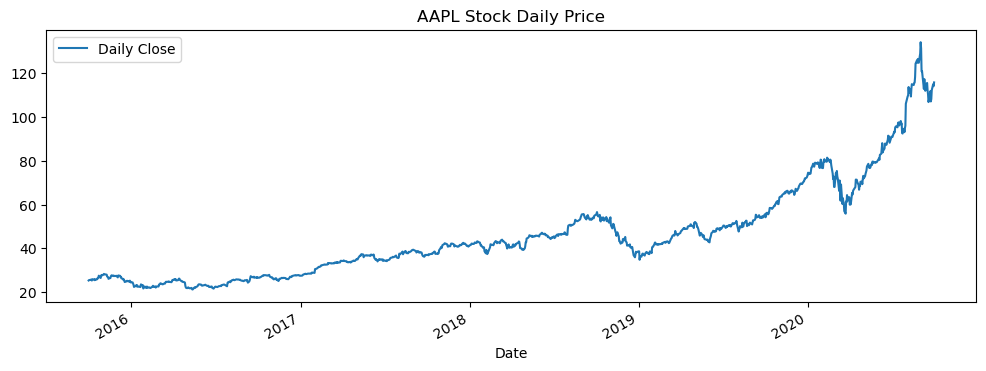

In [ ]:
# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('AAPL Stock Daily Price')
plt.show(block=False)

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

In [ ]:
# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]


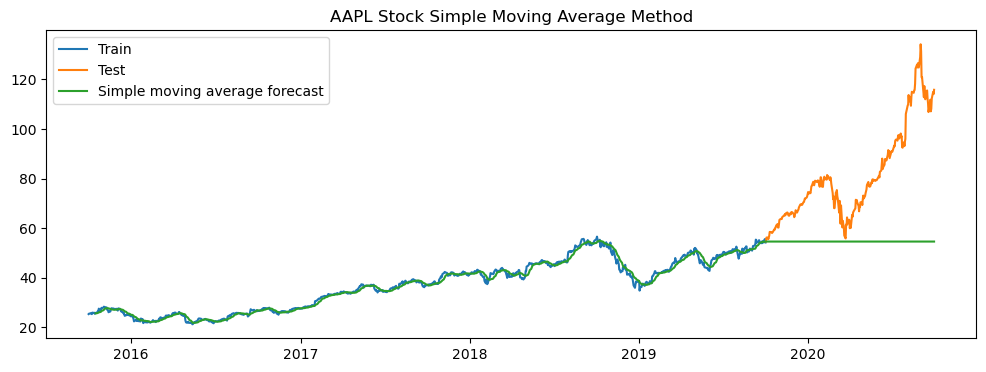

In [ ]:
# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('AAPL Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE
from sklearn.metrics import mean_squared_error
rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,32.58,29.38


### AMZN Stock

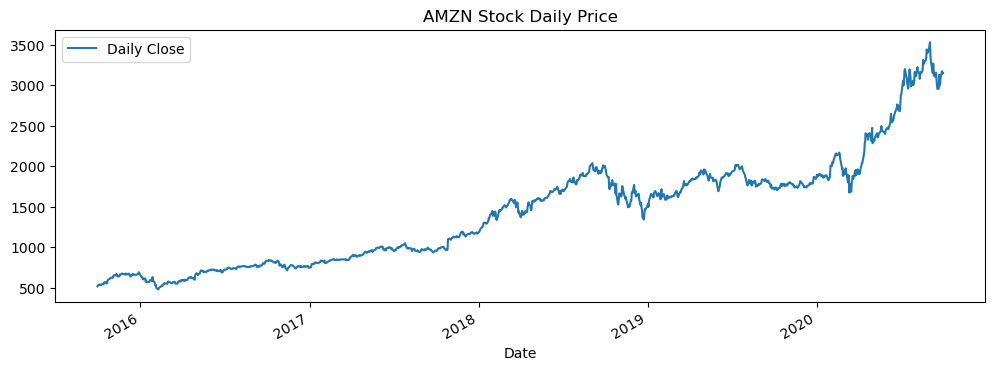

In [ ]:
data = AMZN_Tech.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing addtional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]

# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')

#setting 'Date' column as index
data = data.set_index('Date')

# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('AMZN Stock Daily Price')
plt.show(block=False)

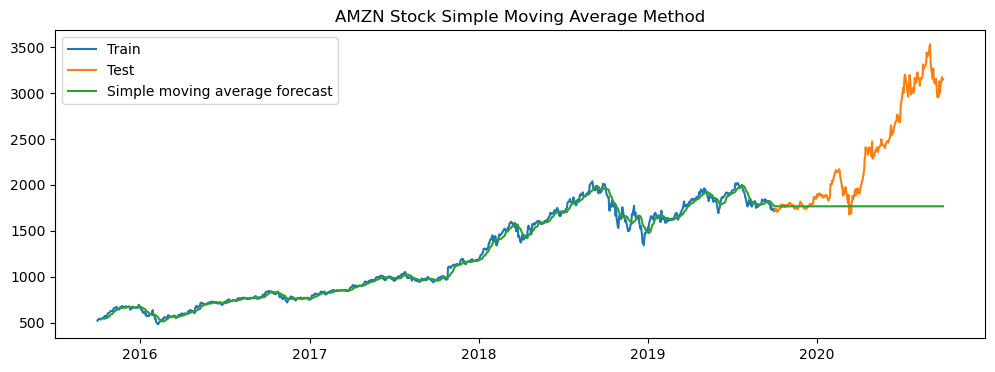

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]

# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('AMZN Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE

rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,788.67,20.29


### MSFT Stock 


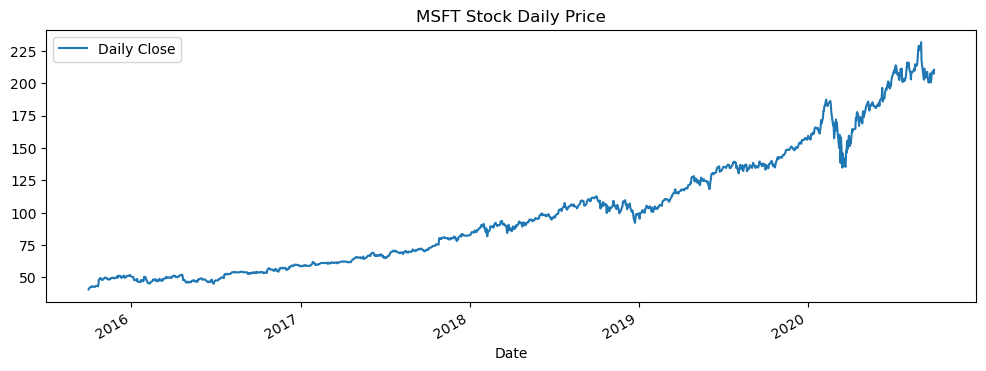

In [ ]:
#loaading data
data = MSFT_Tech.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing addtional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]

# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')

#setting 'Date' column as index
data = data.set_index('Date')

# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('MSFT Stock Daily Price')
plt.show(block=False)

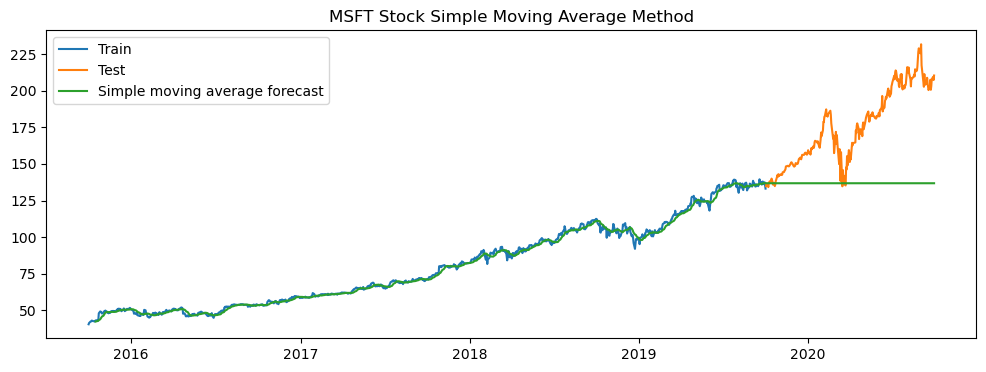

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]

# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('MSFT Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE

rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,46.27,20.31


### MS STOCK

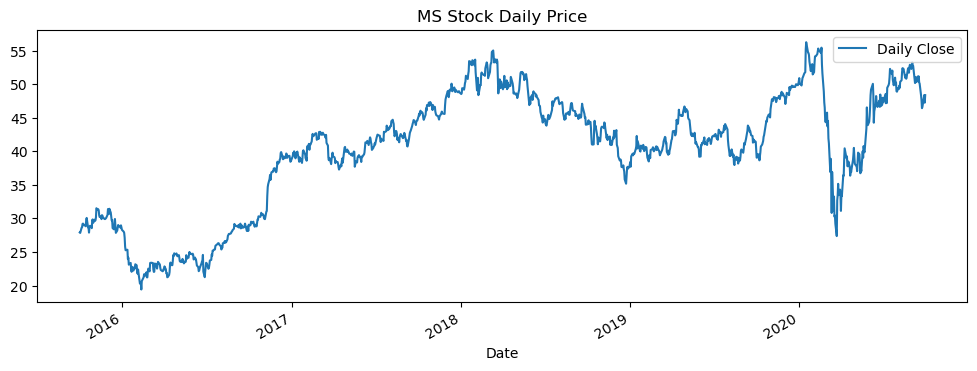

In [ ]:
#loaading data
data = MS_Fin_df.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing addtional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]

# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')

#setting 'Date' column as index
data = data.set_index('Date')

# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('MS Stock Daily Price')
plt.show(block=False)

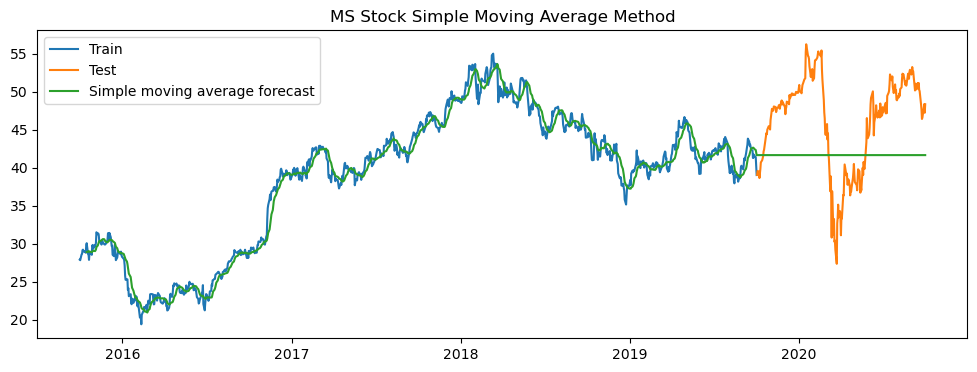

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]

# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('MS Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE

rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,7.62,14.75


### ALK Stock

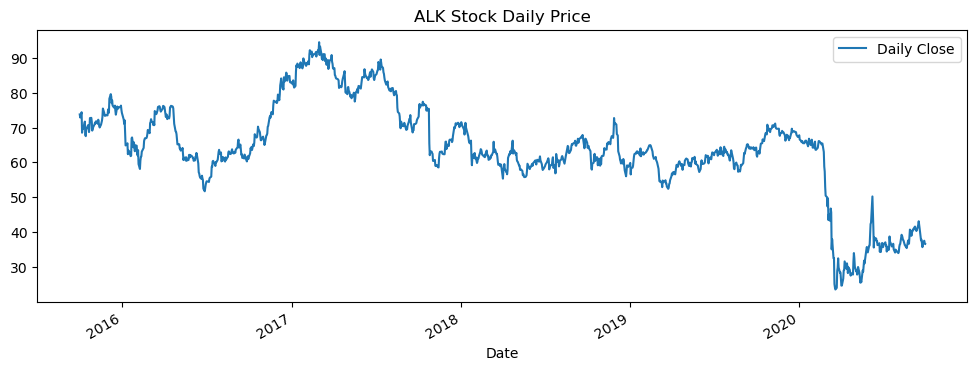

In [ ]:
#loaading data
data = ALK_Avi_df.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing addtional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]

# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')

#setting 'Date' column as index
data = data.set_index('Date')

# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('ALK Stock Daily Price')
plt.show(block=False)

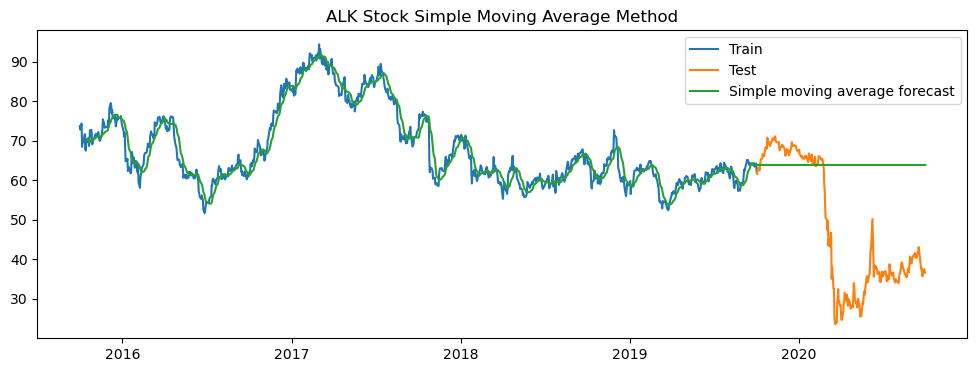

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]

# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('ALK Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE

rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,22.75,53.65


### HA STOCK

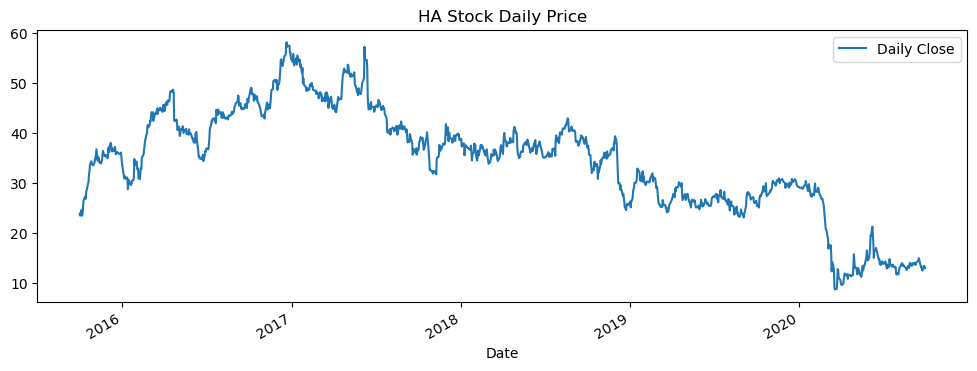

In [ ]:
#loaading data
data = HA_Avi_df.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing addtional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]

# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')

#setting 'Date' column as index
data = data.set_index('Date')

# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('HA Stock Daily Price')
plt.show(block=False)

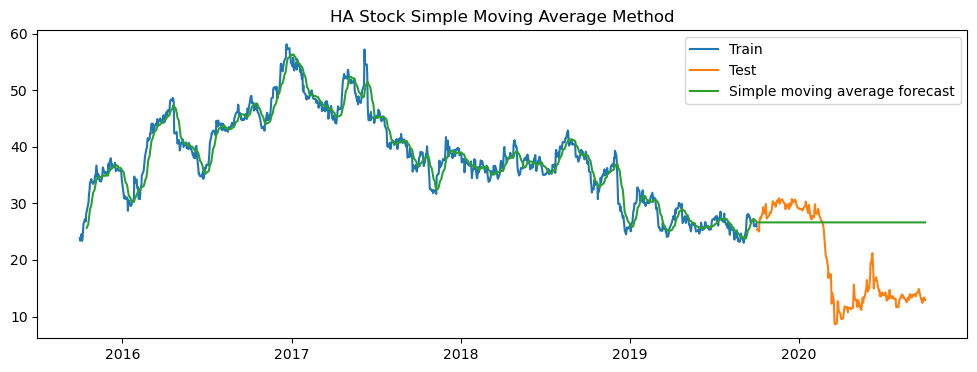

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]

# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('HA Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE

rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,10.42,64.46


### GS STOCK

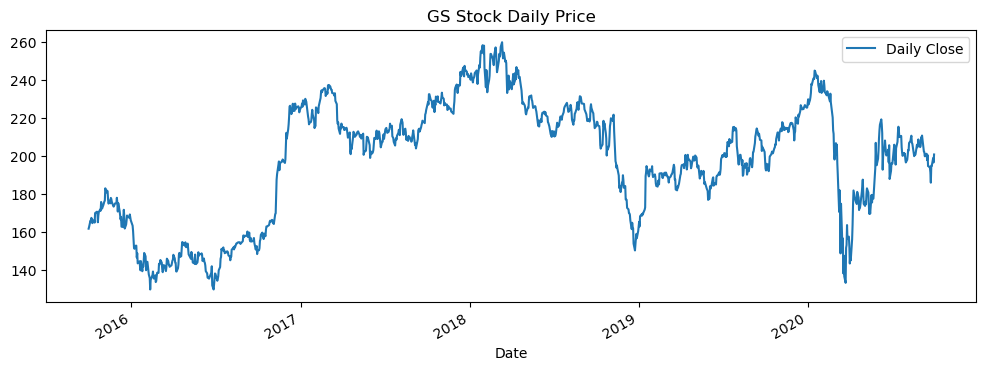

In [ ]:
#loaading data
data = GS_Fin_df.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing aditional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]

# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')

#setting 'Date' column as index
data = data.set_index('Date')

# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('GS Stock Daily Price')
plt.show(block=False)

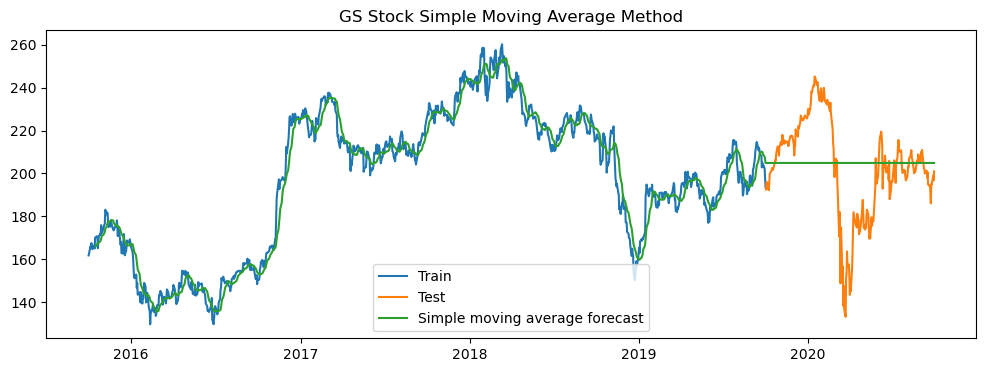

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]

# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('GS Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE

rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,22.94,9.08


### DAL Stock

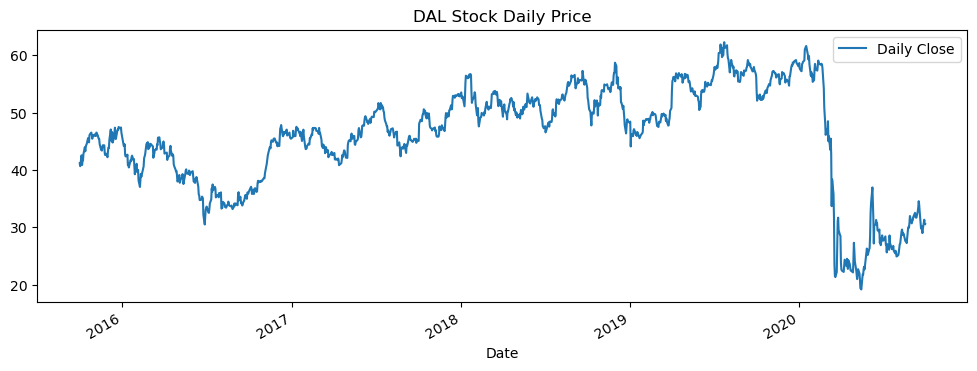

In [ ]:
#loaading data
data = DAL_Avi_df.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing aditional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]

# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')

#setting 'Date' column as index
data = data.set_index('Date')

# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('DAL Stock Daily Price')
plt.show(block=False)

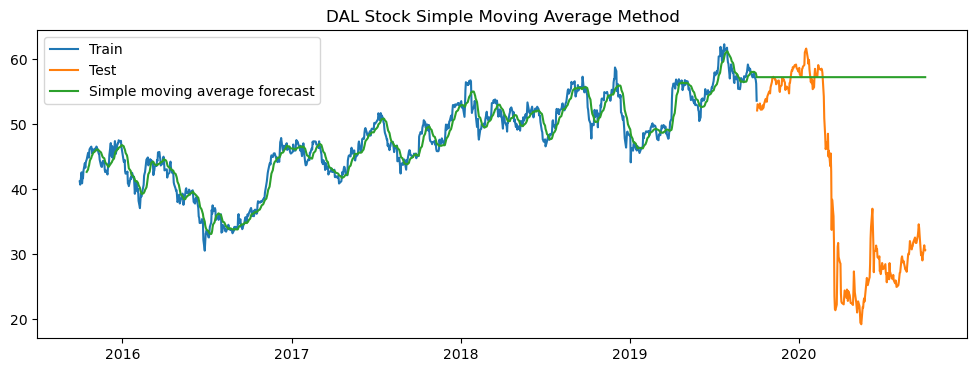

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]

# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('DAL Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE

rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,22.76,66.29


### BHC Code

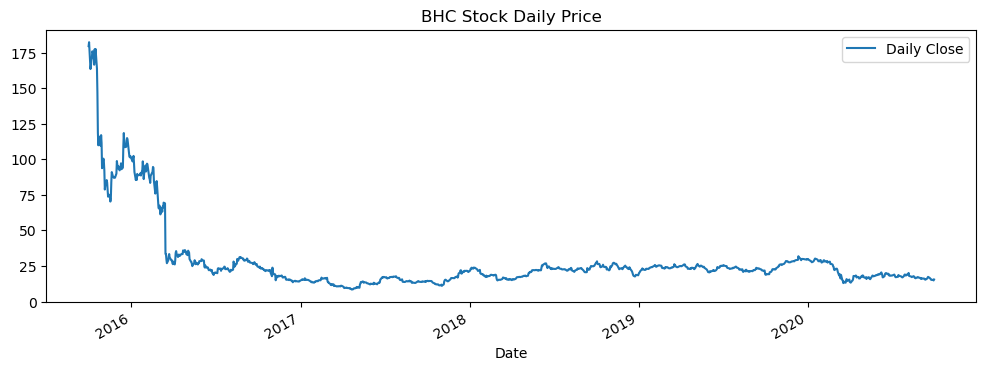

In [ ]:
#loaading data
data = BHC_Pharma_df.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing aditional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]

# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')

#setting 'Date' column as index
data = data.set_index('Date')

# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('BHC Stock Daily Price')
plt.show(block=False)

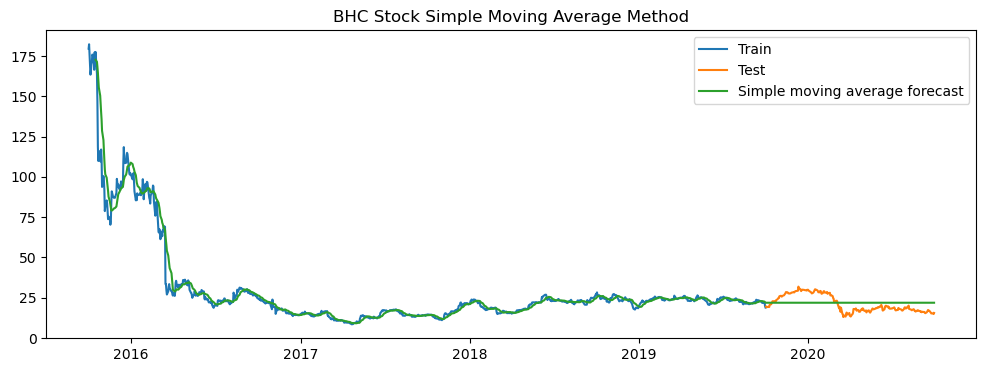

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]

# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('BHC Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE

rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,5.29,24.08


### WFC Stock

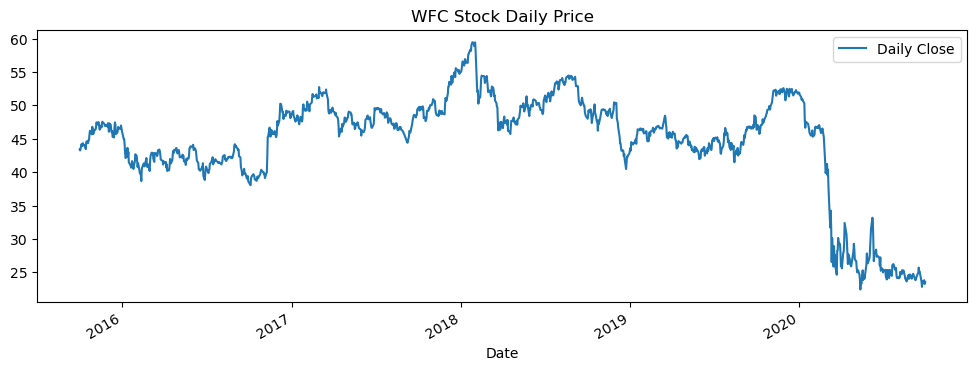

In [ ]:
#loaading data
data = WFC_Fin_df.drop(columns=['Open','High','Low','Close','Volume'])
data.columns = ['Date','Daily Close']

# Removing aditional data, if any,  based on the dates given
data = data.loc[(data['Date'] >= '2015-10-01')
                     & (data['Date'] <= '2020-09-30')]

# Changing the date column to datetime type
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')

#setting 'Date' column as index
data = data.set_index('Date')

# Plopt time series data
data.plot(figsize=(12, 4))
plt.legend(loc='best')
plt.title('WFC Stock Daily Price')
plt.show(block=False)

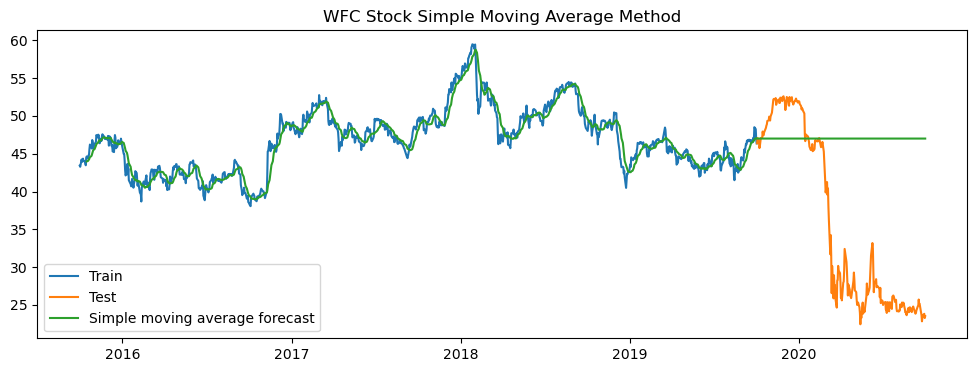

In [ ]:
# Train - test split
train_len = 1008
train = data[0:train_len] # first 4 years as training set
test = data[train_len:] # last 1  year as out-of-time test set

# Simple Moving Average Model
y_hat_sma = data.copy()
ma_window = 12
y_hat_sma['sma_forecast'] = data['Daily Close'].rolling(ma_window).mean()
y_hat_sma['sma_forecast'][train_len:] = y_hat_sma['sma_forecast'][train_len-1]

# Plot test and train and forecast
plt.figure(figsize=(12,4))
plt.plot(train['Daily Close'], label='Train')
plt.plot(test['Daily Close'], label='Test')
plt.plot(y_hat_sma['sma_forecast'], label='Simple moving average forecast')
plt.legend(loc='best')
plt.title('WFC Stock Simple Moving Average Method')
plt.show()

In [ ]:
# Calculate RMSE and MAPE

rmse = np.sqrt(mean_squared_error(test['Daily Close'], y_hat_sma['sma_forecast'][train_len:])).round(2)
mape = np.round(np.mean(np.abs(test['Daily Close']-y_hat_sma['sma_forecast'][train_len:])/test['Daily Close'])*100,2)

results = pd.DataFrame({'Method':['Simple moving average forecast'], 'RMSE': [rmse],'MAPE': [mape] })
results = results[['Method', 'RMSE', 'MAPE']]
results

,Method,RMSE,MAPE
0,Simple moving average forecast,16.09,49.25


#### It is observed that the simple moving average method is not giving very good result as RMSE and MAPE values are high in all the cases. It is required to ARIMA model to improve the performance. However predicting the stock prices for a very long duration based  on technical anaysis is very difficult as there are many other factors like government policies, natural calamities, war etc. All these can affect the stock prices very randomly and it is very difficult to forcast it properly just by using technical analysis. Fundamental analysis plus technical analysis of the stocks can definitely help to improve the prediction of stock prices. 